# FIT5226 Project Stage 3 Group 1

MEMBERS :
- Michelle Adeline (31989101)
- Pay Quan Bi (31248403)
- Chan Jia Zheng (32223315)
- Zoe Low Pei Ee (31989985)

TUTOR : Dr. Fuad Noman

# 1. Implementation

## Imports

In [1]:
# loads classes and functions to implement task
from modules.env import Environment, EnvironmentElement
from modules.history import History
from modules.agent_movement import TypeOneAgent, TypeTwoAgent, Movement, MoveDown, MoveLeft, MoveRight, MoveUp
from modules.reward import Reward
from modules.engine import Engine, init_training
from modules.qlearning import QLearning, DeepQLearning
from modules.policies import Boltzmann, EpsilonGreedy, Pursuit, MonteCarlo
from modules.losses import L2_Loss, L1_Loss
from modules.constants import *
from modules.viz import Visualization
from modules.search import hyperparam_search
from modules.grid_test import test_grids, test_grids_viz
from modules.model import Baseline, Dueling, QNetwork

# import libraries
import numpy as np
import matplotlib.pyplot as plt
import random
import torch
import torch.optim as optim
import torch.nn as nn

In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

Setting seed for reproducibility

In [3]:
torch.manual_seed(42)
np.random.seed(42)
random.seed(42)

## Environment

To implement the GRID WORLD that is scalable and generalisable, Object-Oriented Programming (OOP) concepts are applied in the design. To follow Separation of Concerns, our design is modularised and consists of the following 2 main classes:
- `Environment` (A class for generating the grids and simulate the environment) located [**here**](modules/env.py)
- `Agent` (A class for mimicking the agent to perform actions in the environment) located [**here**](modules/agent_movement.py)

To modularize the components, supported classes are created to allow flexibility and scalability. The following shows some of the supported classes.
- `History` (A class used to keep track of the states, actions, rewards in each episode) located [**here**](modules/history.py)
- `Movement` (A class used for representing the action space) located [**here**](modules/agent_movement.py)

In order to create a scalable solution, we have listed the main measures taken to implement this below:
- `Environment` class
    - accepts a `grid_size` parameter which is used to create a grid world of any (width, height)
    - `loc_a`, `loc_b` as optional parameters, if any of the locations are provided then they are fixed throughout the task, otherwise they are randomly generated. Thus the code is generalizable to fixed as well as random locations.
    - allows resetting (see `reset` method) which will re-generate the grid world and all its elements back to its initialized state with random agent locations and random A and B locations (if they are not fixed) while also allowing the option to fix the agents, A, B locations for a particular run (for evaluation)
- `Agent` class
    - has an `env` attribute which allows it to stay in sync with the environment configuration, possible movements are ascertained by the environment so that the agent automatically adapts to any grid world

This gives an overview of the design which is greatly modularized to ensure great scalability. 


## Agent 
(see code [**here**](modules/agent_movement.py))

To implement the two types of agents in a scalable and generalisable manner, we again make use of Object-Oriented Programming (OOP) concepts. In particular, we have an abstract `Agent` class which holds properties and implements functionalities that are common between the different agent types to avoid repetition, some important ones are mentioned below:
- `move`: the ability to move the agent within the anvironment.
- `reset`: the ability to reset the agent back to each of their initial conditions.
- `get_other_agents`: the ability to find other agents in the environment.

The two agent types are implemented as subclasses of this abstract `Agent` class. 

**Each agent accepts a reference to a `Learning` object (in this case, this is the Deep Q Learning model) responsible for suggesting the moves to the agent.**

*brief note about targets: this represents the target of an agent at a particular step in the episode and are used as part of the state of the agent for mode="absolute_positions" or used implicitly to calculate the state for mode="single_relative_position" (see Task Description section below)*

### `TypeOneAgent`

Represents a type I agent. Its target is initialized as location A. On every turn, when moving it performs the following steps:
- updates current target: checks whether the agent has an item, if so switch its target to the closest type II agent, otherwise if it does not hold an item, its target remains at location A.
- performs the move suggested by the learning algorithm (its deep Q network).
- after the move, it checks:
    - if it is now at A and does not hold the item. If so, the agent then picks up an item from A and switches its target to the closest type II agent with the intention of performing a handover.
    - if it holds an item and it is standing on a tile with at least 1 other type II agent, it arbitrarily hands over the item to the first of the type II agents, and finishes its episode.

### `TypeTwoAgent`

Represents a type II agent. Its target is initialized as the closest type I agent. On every turn, when moving it performs the following steps:
- updates current target: checks whether the agent has an item, if so switch its target to location B. Otherwise, either sets the target to the closest type I agent holding an item, otherwise, the closest type I agent (where closeness is defined based on the state mode, see Task Description section below).
- after the move: 
    - (if the type II agent does not have an item:) it checks whether the agent is currently in a grid cell with a type I agent carrying an item, if so then it then performs a handover (item is transferred between the type I and the type II agent) 
    - (if the type II agent is holding an item:) it checks whether the agent is at B. If so, it has reached its target. It delivers the item to B and finishes its episode.


Adding new agents to the environment is seamless and does not require modification of any of the classes as we simply need to instantiate `TypeOneAgent` or `TypeTwoAgent`, passing in the `Environment` object, the `Learning` method/model, and the state mode.

## Task Description

4 agents must learn to navigate the grid world. 

Two agents are type I agents which are responsible for:
1. navigating to location A (and thus automatically picking up the item there)
2. handing over the item to a type II agent (by meeting with such an agent in a particular grid cell)


The other two agents are type II agents which are responsible for:
1. receiving an item from a type I agent (by meeting with such an agent in a particular grid cell)
2. navigating to location B with the item (and thus delivering the item to B)

Each agent can only carry one item at a time. 

Locations A and B are fixed to the top-left corner of the grid world (`[0,0]`) and the bottom-right corner of the grid world (`[gridsize-1, gridsize-1]`) respectively.

The agents must learn to do their tasks regardless of where they are spawned in the grid world as the agent locations are randomized at the start of each episode.

### Episodes

A learning episode is finished if either condition is satisfied:
- all agents' individual episodes are completed, or
- the maximum step count (10,000) has been exceeded.

Each agent's individual episode ends once they have completed their responsibilities:
- For type I agents, their episode ends after handing over the item to a type II agent. 
- For type II agents, their episode ends after navigating to location B (with the item). 

After the agent's individual episode ends, they are removed from the grid world and can no longer perform any further actions (because they are done with their tasks).

### State space
We have experimented with two different types of states:

#### `single_relative_target` $\in \mathbb{Z}^2$
This approach is similar to the state we employed for Stage 1 and 2 where we have formulated our state as the (x,y) position relative to the target (A/B/closest other agent). 

Let (u, v) be state.  
Let (x, y) be grid size.  

Based on our implementation:
1. u is the horizontal position of agent with respect to the target (A/B/closest other agent). u ∈ [-(x-1), (x-1)]
2. v is the vertical position of the agent with respect to the target (A/B/closest other agent). v ∈ [-(y-1), (y-1)]
3. Position of target relative to itself is at (0 ,0) 

Target is defined for each agent to be:
-  For Type I agents:
    - (before they pick up the item:) target is location A.
    - (after they pick up the item:) target is the closest type II agent.

- For Type II agents:
    - (before they receive the item:) target is the closest type I agent holding an item (or if none of the type I agents are holding an item, it targets the type I agent closest to this agent)
    - (after they receive the item:) target is location B.

#### `absolute_positions` $\in \mathbb{W}^5$
Let (x, y) be grid size. 
Our state consists of: [pos_x, pos_y, target_x, target_y, has_item], where:
- pos_x: is the absolute x position of the agent (pos_x ∈ [0, x-1])
- pos_y: is the absolute y position of the agent (pos_y ∈ [0, y-1])
- target_x: is the absolute x position of the target (target_x ∈ [0, x-1])
- target_y: is the absolute y position of the target (target_y ∈ [0, y-1])
- has_item: 1 if the agent is holding an item, 0 otherwise.

Target is defined for each agent to be:

- For Type I agents:
    - (before they pick up the item:) target is location A.
    - (after they pick up the item:) target is the closest type II agent.

- For Type II agents:
    - (before they receive the item:) target is the closest type I agent holding an item (or if none of the type I agents are holding an item, it targets the type I agent closest to location A)
        - why the type I agent closest to A? because it stands to reason that such an agent would pick up the item first before the other agent further away from A.
    - (after they receive the item:) target is location B.

### Action space
Our Q-Agent can move in the four cardinal directions -- Up, Down, Left, Right.

However, if it is adjacent to one or more of the four corners of the grid world, then its movements are limited. For example, if it is adjacent to the right corner of the grid world, it cannot move Right (since then it would move off the map!)

Note that the following measure has been taken to implement a scalable solution:
- `Movement` class
    - agents will check for subclasses of `Movement`, thus if we want to add another movement to the task, we can simply inherit `Movement` class and all agents will be able to use this movement without changing the `Agent` code at all!

*Note: the two type I agents receive a reference to a single learning object. The two type II agents also receive a reference to a single learning object, i.e. agents of the same type share the same Deep Q Learning model*

### Reward Structure

Our reward structure can be split into 2 cases:
- **when they reach their target**: the agent receives a TARGET_REWARD for the (state,action) pair which brought them to their target. This TARGET_REWARD is set empirically to 200 based on testing (the value needs to be quite high to counter the quadratic move penalty). On top of this, it receives a penalty for the number of moves the agent took to reach the target from the starting position
    - *(note: if this is the first target that the agent has reached, the starting position is its initial spawn position. If this is the second target the agent has reached, the starting position is the position it was at when it reached the first target)*
- **when they reach a non-target position**: the agent receives a BASE_REWARD of -1. On top of this, to speed up training, we multiply this base reward with an occupancy grid penalty based on the number of times it has visited a particular grid cell. The more it has visited a particular location, the larger the penalty.

As the agent aims to maximize the reward, the TARGET_REWARD and BASE_REWARD are positive and negative respectively to encourage the agent to reach the target in fewer steps. The imposed penalty on the number of moves helps incentivizes the agents to reach their targets in as few steps as possible and the imposed occupancy grid penalty encourages it not to revisit positions it has already visited before, i.e. doubling back to the same positions. This is based on the concept that a shortest path between two points should not have repeated nodes.

*Note: due to random generation of the agent locations and the fact that each agent has 2 targets, sometimes the shortest path to the second target necessitates retracking part of the same path taken to reach the first target, thus we have seperate occupancy grids associated with each target.*

Implementation detail:
- the move number penalty is made possible by recording the move number at which each agent reaches its targets. 
    - For example: [4, 10] means that the agent reaches its first target at move 4 and its second target at move 10. Thus the move penalty when they reach the first target is $4^2$, and for the second target is $(10-4)^2$ (this information is recorded in the `History`)
- the occupancy grid penalty is made possible by recording the occupancy of each grid cell in the environment for each target of each agent (this information is recorded in the `History`)

To further improve the convergence and avoid the agent from locking itself in a loop during evaluation step due to incomplete policy learning, the maximum steps taken by agent per episode is integrated such that the agent would receive large penalty for not reaching the target within maximum number of steps per episode. This will allow the agent to learn the ideal path and ultimately take minimum steps to reach the target. For simplicity, the maximum steps is chosen to be double of the number of grids in the environment to accommodate delivering the item to B within a single episode. Importantly, this large penalty is spread out over the (state, action) pairs of the agents for the entire episode to penalize the entire sequence instead of just heavily penalizing the latest (state, action) pair

Overall, the reward function could be summarized in the following equation.

\begin{align*}
    \forall (s,a) \in S_i \times A_i, \forall i,  \\
    R(s, a) &= \begin{cases}
        \text{TARGET\_REWARD} - \text{NUM\_MOVES} ^ 2 & \text{ if the agent is at its target (see Agent section above) } \\
        \text{BASE\_REWARD} \times \text{NUMBER\_OF\_VISITS} & \text{ if the agent is not at its target (see Agent section above) } \\
        -100 / \text{TOTAL\_NUM\_MOVES} & \text{ if maximum steps is reached, penalty is equally spread between all (s, a) pairs }
    \end{cases}
\end{align*}

where $S_i \times A_i$ is the set of (state, action) pairs performed by agent $i$ during a particular episode, and $\text{NUM\_MOVES}$ is the number of moves taken by the agent since it reached its last target (or its spawn position if it has yet to reach a target during the episode)

Relevant classes are:
- `Reward` (A class for integrating the reward structure described above) located [**here**](modules/reward.py)

## Deep Q-Netwok

A Deep Q-Network (DQN) is a reinforcement learning algorithm that combines deep neural networks with Q-learning, a popular tabular algorithm for solving Markov decision processes. The main idea behind DQN is to use a deep neural network to approximate the Q-values by stochastic gradient descent, which represent the expected future rewards for taking different actions in a given state. The following describes few important elements in Deep Q-Network

### Q-Value Update

In general, the optimal action-value function obeys the Bellman Equation which is based on the following intuition: If the optimal value, $Q^{*}(s', a')$ of the sequence $s'$ at the next time-step was known for all possible actions $a'$, then the optimal strategy is to select the action $a'$ which maximizes the expected value $r + \gamma Q^{*}(s', a')$. Mathematically speaking, we have

\begin{equation*}
    Q^{*}(s, a) = \mathbb{E}_{s' \sim \varepsilon}[r + \gamma \max_{a'} Q^{*}(s', a') \; | \; s, a]
\end{equation*}

Unlike the tabular Q-learning which uses Bellman equation for iterative update such that

\begin{equation*}
    Q_{i+1}(s, a) = \mathbb{E}[r + \gamma \max_{a'} Q_{i}(s', a') \; | \; s, a]
\end{equation*}

DQN with parameters $\theta$ is trained by minimising a sequence of loss function, $L_i(\theta_i)$ which changes at each iteration

\begin{equation*}
    L_i(\theta_i) = \mathbb{E}_{s, a \sim \rho (\cdot)}[(y_i - Q(s, a;\theta_i))^2]
\end{equation*}

where 

\begin{equation*}
    y_i = \mathbb{E}_{s' \sim \varepsilon}[r + \gamma max_{a'} Q(s', a'; \theta_{i-1})\;|\;s, a]
\end{equation*}

is the target for iteration $i$ and $\rho(s, a)$ is a probability distribution over sequences $s$ and actions $a$ that we refer to behaviour distribution. The parameters from the previous iteration $\theta_{i-1}$ are held fixed when optimising the loss function $L_i(\theta_i)$ to emulate fixed target in conventional supervised learning. With that, differentiating the loss function, we obtain an update gradient as follows.

\begin{equation*}
    \mathbb{E}_{s, a \sim \rho (\cdot); s' \sim \varepsilon}[(r + \gamma max_{a'} Q(s', a';\theta_{i-1} - Q(s, a; \theta_i))\Delta_{\theta_i}Q(s, a;\theta_i)]
\end{equation*}

From the above equation, we note that DQN agent updates its Q-network by minimizing the mean squared error between the predicted Q-values and the target Q-values. Note the target Q-values are dependent on the weights of the network weights, resulting in unstable learning at each update. To address the issue, a target network which is a separate network but with the same initialized weights as the network is created and periodically updated to match the weights of the network in order to simulate the effect of policy iteration. In practice the behavioural distribution, $\varepsilon$ is selected to follow $\epsilon$-greedy policy.

### Experience Replay

Instead of conducting the weight updates incrementally for each sample as in Tabular Q-Learning, experience replay is introduced to improve the training stability by reducing correlation between consecutive samples while also allowing a single batch update. 

The idea is simple: batches of states, actions and rewards are randomly sampled from the past experience (that has yet been used) and is used to update the weights of the network. Through random sampling, temporal correlation in the agent's experiences are disrupted and hence agent is exposed to more diverse set of experiences which greatly reduces the bias and variance during learning. On the other hand, sampling from past experiences allows a good trade-off between exploration and exploitation as agent may utilize important experiences which may not necessarily be recent. With that, the training could be stabilized with less dependent relationship between the order of encountered experiences.

### Double Q-Learning Variant

In tabular method, a double q-learning would maintain 2 sets of Q values, namely $Q_1(s, a)$ and $Q_2(s, a)$. The idea is to create an unbiased estimator from the 2 sets of Q values. The update rule would be as follows.

\begin{align*}
    Q_1(s, a) &\leftarrow{} Q_1(s, a) + \alpha (r + \gamma Q_2(s', \arg\max_a Q_1(s', a)) - Q_1(s, a)) \\
    Q_2(s, a) &\leftarrow{} Q_2(s, a) + \alpha (r + \gamma Q_1(s', \arg\max_a Q_2(s', a)) - Q_2(s, a))
\end{align*}

The 2 update rules are interleave with a predefined probability. Transfering the knowledge to Deep Q-Network, we could rewrite the evaluation of DQN target to be

\begin{equation*}
    y_i = \mathbb{E}_{s' \sim \varepsilon}[r + \gamma Q(s', max_{a'} Q(s', a'; \theta_{i-1}); \theta_{i-1})\;|\;s, a]
\end{equation*}

Replacing $y_i$ to the loss gradient function in DQN above, we obtain an update gradient as follows.

\begin{equation*}
    \mathbb{E}_{s, a \sim \rho (\cdot); s' \sim \varepsilon}[(r + \gamma Q(s', max_{a'} Q(s', a';\theta_{i-1}); \theta_{i-1}) - Q(s, a; \theta_i))\Delta_{\theta_i}Q(s, a;\theta_i)]
\end{equation*}

Since we require 2 models, namely target and prediction model, Double DQN could be easily realized by replacing the update rule in existing implementation without any modification on the network structure. However, such simple idea could reduce overoptimism in the estimate of DQN and find a better policy as compared to DQN.

### Multi-Agents System
In order to accommodate the existence of multiple agent types with different behaviours and goals, agents of the same type will share the same DQN. Note that each DQN would use the same update rule and the policy is learnt to match with the agents' goal. That being said, DQN for each type of agent would have different weights for each state and hence providing different best action according to the scenario.

Since there are multiple agents of same type sharing the same DQN, the implementation of experience replay would be adapted to sample the experiences from multiple agents of same type instead of a single agent. Such sampling provides a higher degree of variety and robustness with increasing number of possible combinations in the sampled experiences. This would further enhance the learning by exploring unseen scenarios. Nonetheless, the sampling is still subjected to the limit of replay buffer.

### Implementation

In our implementation, to accommodate the dual network training scheme, we have maintain 2 models, namely prediction and target network which shares the same structure and same weights during initialization. Our model is kept minimally simple with 3 hidden linear layers using ReLU activation function. Following the convention, $\epsilon$-greedy policy is chosen as the behavioral distribution scheme. However, for experimental purpose, the number of layers, type of activation function and behavioral policy could be changed due to the flexible implementation.

Also, note that the above update rule is based on Mean-Squared Error. However, in our implementation, we have chosen SmoothL1Loss, defined as

\begin{equation*}
    L(\hat{y}, y) = \begin{cases}
        \frac{0.5(\hat{y} - y)^2}{\beta} & \text{ if } |\hat{y} - y| < \beta \\
        |\hat{y} - y| - 0.5\beta & \text{ otherwise}
    \end{cases}
\end{equation*}

to be our loss function for updating the weights as we find that it greatly matches with the state representation and results in better training convergence.

In our implementation, instead of sampling from the entirety of the past experiences, we only allow the replay buffer to store the experiences that minimally exceed the batch size for every episodes. This would ensure the efficient use of memory and reduce the time complexity of sampling from numerous experiences. However, this comes with a minor drawback such that the training convergence is slower as compared to using a larger buffer memory. Additionally, `not_done` mask is included in the sampling process due to the modifications in the state representation as described above. With that, we have to cater for (state, action) pairs which leads to the ending position and hence update the Q-value using the correct discount factor accordingly. The target value in the update rule could be formulated as follows.

\begin{equation*}
    \hat{Q}(s_t, a_t;\theta) = \begin{cases}
        r + \gamma \max_{a_{t+1}} \hat{Q}(s_{t+1}, a_{t+1}; \theta) & \text{ if } s_t \text{ is not ending state} \\
        r & \text{ Otherwise}
    \end{cases}
\end{equation*}
where $\hat{Q}$ is the target network, $r$ is the reward at each state $s$

Other than that, instead of maintaining only 1 network as in previous stage, we have to maintain 2 networks for 2 types of agent. `Engine` class has been modified to adapt to such scenario with scalable design using Python list for storing the networks. For further details, please refer to the relevant classes stated below.

Relevant classes are:
- `Learning` (A class for implementing the learning mechanism, i.e. Q-Learning) located [**here**](modules/qlearning.py)
- `QNetwork` (A class for implementing the Deep Q-Network design) located [**here**](modules/model.py)
- `Engine` (A class for running simulation, either training or evaluating the agent) located [**here**](modules/engine.py)
- `Policy` (A class for implementing the behavioural policy used in Q-Learning) located [**here**](modules/policies.py)

In [4]:
GRID_SIZE = [5, 5]
LOC_A = [0, 0]
LOC_B = [x-1 for x in GRID_SIZE]

The code below initializes the necessary configurations (setting up history, environment, instantiating DQN models, creating and registering the 4 agents within the environment, and setting up the engine) for a training episode for both `single_relative_target` and `absolute_positions`.

In [5]:
# Single Relative Target
env, history, eval_history, engine = init_training(grid_size=GRID_SIZE, loc_a=LOC_A, loc_b=LOC_B, 
                                                   update_intervals=(175, 325), mode="single_relative_target", 
                                                   gamma=0.9, tau=0.5, lr=0.01, double=False)

# Absolute Position
env_2, history_2, eval_history_2, engine_2 = init_training(grid_size=GRID_SIZE, loc_a=LOC_A, loc_b=LOC_B, 
                                                           update_intervals=(175, 325), mode="absolute_positions", 
                                                           gamma=0.9, tau=0.5, lr=0.01, double=False)

## Training & Testing

As described above, class `Engine` is responsible for training and evaluating the agents in recognizing the ideal path to point A, efficient handoff point and point B. On the other hand, supported class, `Loss`, is utilized to evaluate the performance of the agents for a given episode or a sequence of episodes.

Following convention from typical practices in Machine Learning training where batch inference is evaluated on unseen dataset for determining the performance of the agent, after every `n` episodes of training we will freeze updates on the DQN models and perform evaluation of the model.

### Training Procedures
During training, **position of agents are randomly generated for every episode** with location A and location B fixed at the top-left and bottom-right corners of the grid respectively. Actions are suggested by the behavior policy (see Deep Q-Network section above) and used for updating the Deep Q-Network after every episode which would eventually approach the target policy. Every episode would run until the predefined maximum step is reached or all agents have completed their individual episodes (see Episodes section above). Note that once an agent has completed its task, it is deemed inactive and would not be involved in the remaining steps of the episode. Such implementation would help stabilize the training and avoid the occurrence of scenarios wherein an agent that has completed its task is left wandering around aimlessly and thus incurring movement penalties as it has no target. On top of that, the agent would have a clear understanding on its goal throughout the learning in this training scheme as the task of agents are well defined and they are stopped once they accomplish their task. The modifications done for adapting multiple collaborating agents to complete a task is the main difference from the training scheme in previous stage. Another difference of our approach from a standard reinforcement learning is our reward structure (Refer to Reward section above).

Following common practice in Machine Learning training, we keep track of models which result in the lowest evaluation losses, and we generally use the model at this state for further evaluation.

For details of implementation of the training scheme, refer to the codes:
- `Engine` (Contains both the training and evaluation procedures) located [**here**](modules/engine.py)

The code below runs training for both modes: `single_relative_position` and `absolute_positions`. Training is performed by default for 3000 episodes. Every 200 episodes, training is frozen and evaluation is performed (described below).

For transparency, for each episode we print out:
- *"New episode"*: which indicates a reset of the environment and agents for a new episode
- *"Type: 1 agent index: $i$ PICKED UP ITEM AT A!"*: which indicates that the $i$-th agent of type I has picked up an item at A.
- *"handover between Type: $t_1$ agent index: $i$ and Type: $t_2$ agent index: $j$"*: which indicates that during the turn of the $i$-th agent (which is of type $t_1$), an item handover occurs between it and the $j$-th agent (which is of type $t_2$).
- *"Type: 2 agent index: $i$ succesfully delivered to B!"*: which indicates that the $i$-th agent of type II has successfully delivered an item to B.
- *"Finish episode!"*: which indicates that all agents have finished their individual episodes (i.e. did not exceed max. step count)

In [6]:
# Single relative target
best_learnings = engine.run()

New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 1 and Type: 2 agent index: 2
Type: 1 agent index: 0 PICKED UP ITEM AT A!
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 1 and Type: 2 agent index: 3
New episode
New episode
Type: 1 agent index: 0 PICKED UP ITEM AT A!
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 3 and Type: 1 agent index: 1
handover between Type: 2 agent index: 2 and Type: 1 agent index: 0
New episode
Type: 1 agent index: 0 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 0 and Type: 2 agent index: 3
New episode
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 1 and Type: 2 agent index: 2
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 2 and Type: 1 agent index: 1
Type: 1 agent index: 0 PICKED UP ITEM AT A!
Type: 2 agent index: 2 succesfully deli

In [7]:
# Absolute Positions
best_learnings_2 = engine_2.run()

New episode
New episode
New episode
New episode
New episode
Type: 1 agent index: 0 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 0 and Type: 2 agent index: 3
Type: 2 agent index: 3 succesfully delivered to B!
New episode
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 2 and Type: 1 agent index: 1
New episode
New episode
New episode
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 1 agent index: 1 and Type: 2 agent index: 3
New episode
Type: 1 agent index: 0 PICKED UP ITEM AT A!
New episode
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 3 and Type: 1 agent index: 1
Type: 1 agent index: 0 PICKED UP ITEM AT A!
New episode
Type: 1 agent index: 0 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 3 and Type: 1 agent index: 0
Type: 2 agent index: 3 succesfully delivered to B!
Type: 1 agent index: 1 PICKED UP ITEM AT A!
handover between Type: 2 agent index: 2 and

# 2. Documentation


### Evaluation Procedures

During evaluation, we freeze the update of the model and we randomly sample 500 spawn positions for all agents in the grid world and we test the model performance on each of these positions. Our final evaluation loss and reward is then the average over the losses and rewards for each of these scenarios.

Using the loss functions (described below), we can determine whether the agent could perform well on seen and unseen configurations based on learnt q-values.

*Note: due to the fully greedy policy, the target policy only exploits with no chance for exploration, thus on early evaluations it could get stuck going back and forth in a small area, to avoid this going on forever, we set a maximum number of steps (2\*grid size) after which the agent is given a large penalty*


### Metrics

For evaluation purpose, we have defined 2 loss functions, namely L1-Loss and L2-Loss as shown below.

\begin{align*}
    L_1(y, \hat{y}) &= |\hat{y} - y| \\
    L_2(y, \hat{y}) &= (\hat{y} - y)^2
\end{align*}

where $\hat{y}$ is the number of steps taken by the agent to reach its target and $y$ is the minimum number of steps taken to reach its target. 

The minimum number of steps taken to reach handoff point is calculated as the L1 distance between the grid positions of Type I and Type II agents at the point in which the Type I agent reaches point A to pick up the item. This number is then divided by 2 to accommodate the fact that both agents could make a move in a single turn, and idealy both would move towards each other. The calculations for point A and point B are simpler as the locations are fixed and non-movable.

The above loss functions serve as an indicator of the learning progress of the agent in finding the ideal path. If the agent is able to find the ideal path, the loss value would eventually converge to 0. The 2 loss functions above are better alternatives than the average rewards as proposed in the lecture since agents' location vary in each episode randomly and hence the average rewards would be affected by random number generator (RNG) in each episode. With that, there are cases where average rewards are high due to short distance between agents, point A and point B if spawn locations happen to be very close to one another and vice versa. To eliminate such ambiguous case, the above 2 loss functions are chosen which are not affected by the random spawns and treats easy and hard scenarios fairly.

For details of implementation of the training and evaluation scheme, refer to the codes:
- `Engine` (Contains both the training and evaluation procedures) located [**here**](modules/engine.py)
- `Loss` (Implements the loss between agent path and ideal path) located [**here**](modules/losses.py)

From the above experiments, we note that under the same settings, `single_relative_target` (Minimum loss : 2323.6235) performs significantly worse than `absolute_positions` (Minimum loss : 0.2385), thus the following sections will use the results obtained from the models trained with the `absolute_positions` mode.

*Although we note that through further fine-tuning the hyperparameters, `single_relative_target` could achieve similar performance as the `absolute_positions` mode.*

## Visualisation

For visualization purpose, multiple techniques have been applied.

For implementation details see: `Visualization` (Class containing all visualization methods and helper methods to process data for visualizing) located [**here**](modules/viz.py)

### **Predicted Q-value Visualization**

By running the trained model on all grid cells, we can find out the predicted Q-values for each Movement for that particular position. Since the network output is in range (-inf, inf) we normalize it by applying a softmax to transform the values into range [0,1], these normalized Q-values are then visualized in a heatmap format.

As you can see below, the predicted q-values are sensible based on the target provided and agent type. When the target is fixed point like location A and B, the policy would direct the agent to the target location. However, when the target is another type of agent (dynamic target), the policy often would not direct the agent to the target but rather somewhere in between as handoff point.

In [10]:
learning_1, learning_2 = best_learnings_2

#### Type I agent with target: Location A
- For `MoveLeft`, q-values are overall high because location A is at [0,0] and thus for most grid cells moving left is the optimal choice, the values are higher when the agent is to the right of location A.
- For `MoveRight`, q-values are low overall except at bottom-left of the grid. However, the values are bested by `MoveUp` and `MoveLeft`. This makes sense since the location A is fixed at [0, 0] thus there is no scenario where the agent should move right.
- For `MoveUp`, q-values are overall very high because location A is at [0,0] and thus for most grid cells moving up is the optimal choice, the q-value is higher when the agent is to the bottom of the target.
- For `MoveDown`, q-values are low overall and bested by `MoveLeft` and `MoveUp`, this makes sense because of the fixed location of A at [0, 0] and thus there is no scenario in which the agent should move down.

Note: for diagonals, the optimal move is either `MoveLeft` followed by `MoveUp` or vice versa as location A is fixed at [0, 0]

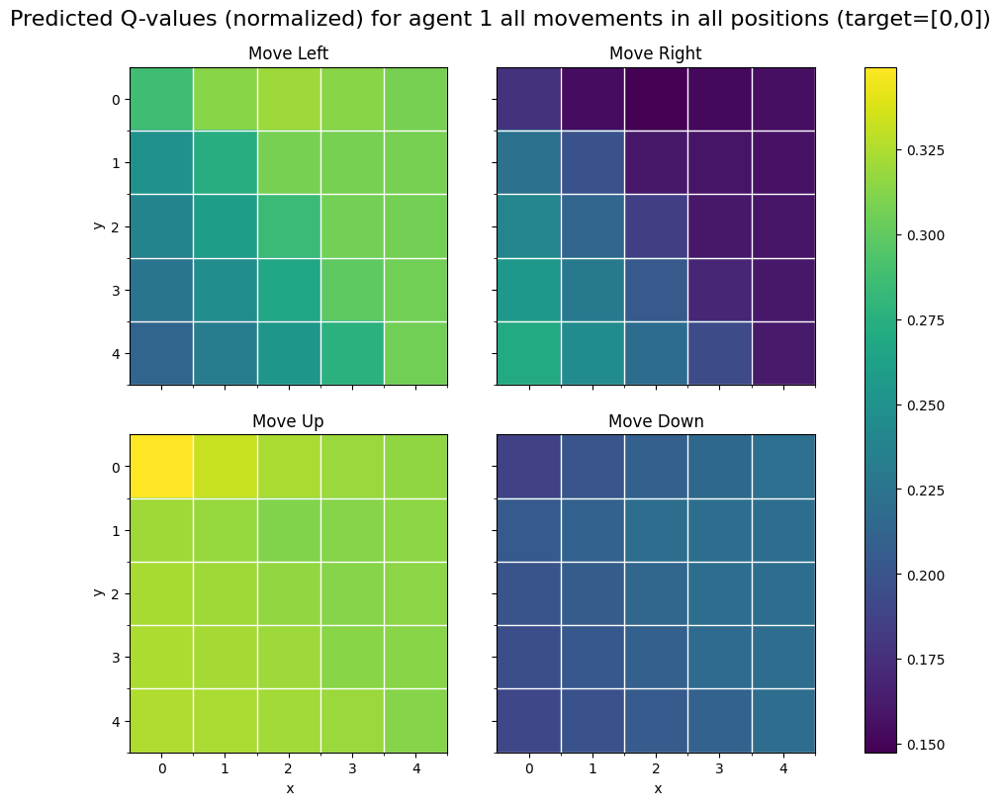

In [9]:
# Type I agent's policy to location A
Visualization.plot_move_qvals_per_state(learning_1.table, env_2, target=LOC_A, has_item=False)

#### Type I agent with target: Type II agent at [1, 3]
- For `MoveLeft`, q-values are low and bested by `MoveRight` and `MoveDown` in all scenarios.
- For `MoveRight`, q-values are high overall and this action is executed most of the times.
- For `MoveUp`, q-values are low and bested by `MoveRight` and `MoveDown` in all scenarios.
- For `MoveDown`, q-values are high overall but bested by `MoveRight` in all positions. This action is executed when `MoveRight` is not a possible move due to grid boundaries.

Note: for diagonals, the optimal move is either `MoveRight` followed by `MoveDown` or vice versa as Type I agent aims at Type II agent only after it reaches location A [0, 0]. Hence, Type II agent is always on the right or bottom of Type I agent. This also explains the above observation of high q-values for `MoveRight` and `MoveDown` actions. However, **it is noted that the policy is not learnt to direct the agent to the target location, i.e. [1, 3] but to the efficient handoff point since Type II agent is moving at the same time**. As such, we notice the efficient handoff point learnt by Type I agent is always on the bottom-right region in the grid.

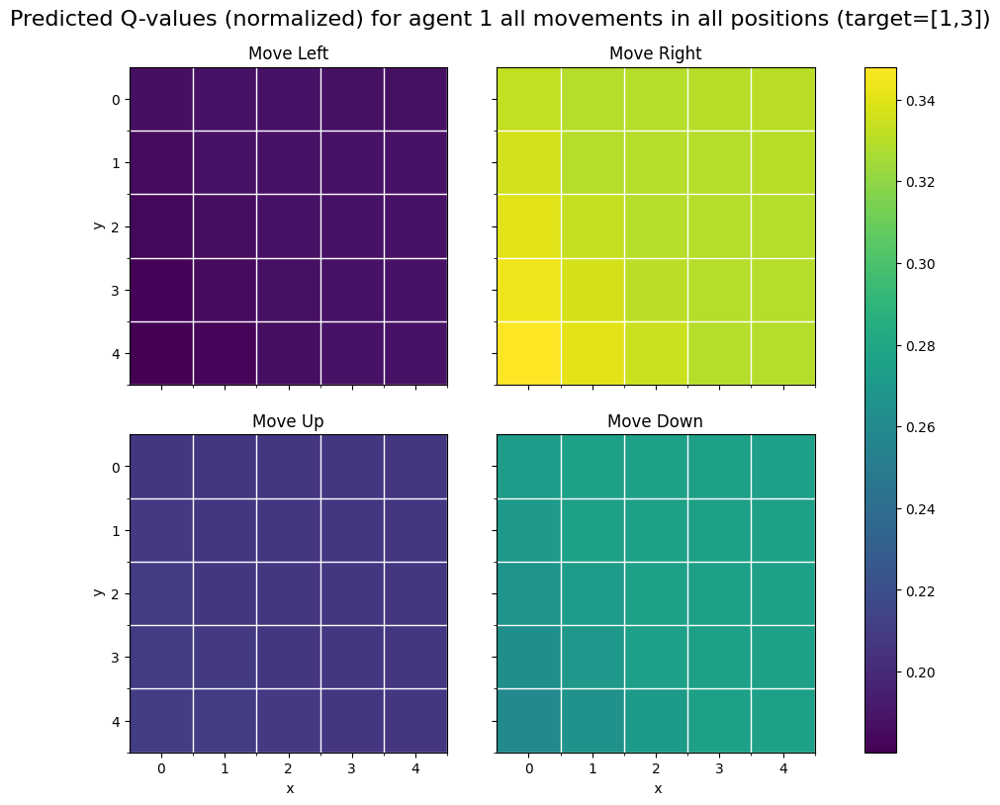

In [10]:
# Type I agent's policy when Type II agent is at [1, 3]
Visualization.plot_move_qvals_per_state(learning_1.table, env_2, target=[1,3], has_item=True,
                                        agent_type=EnvironmentElement.AGENT_TYPE_1)

#### Type II agent target: Type I agent at [0, 0]
- For `MoveLeft`, q-values are high and only bested by `MoveUp` at bottom-right region of the grid.
- For `MoveRight`, q-values are low overall and this action is executed only when agent is at top-left corner of the grid.
- For `MoveUp`, q-values are high at bottom-right region of the grid.
- For `MoveDown`, q-values are low and bested by all other actions at all scenarios.

Note: for diagonals, the optimal move is either `MoveLeft` followed by `MoveUp` or vice versa as Type II agent aims at Type I agent at [0, 0]. This also explains the above observation of high q-values for `MoveLeft` and `MoveUp` actions. However, it is noted that the policy is not learnt to direct the agent to the target location, i.e. [0, 0] but to the efficient handoff point since Type I agent is moving at the same time. As such, we notice the efficient handoff point learnt by Type II agent is always on the top-left region in the grid. Moreover, we note that the learnt policy is matched with that of Type I agent. **This shows that the agents are meeting at efficiently chosen handoff point rather than random places.**

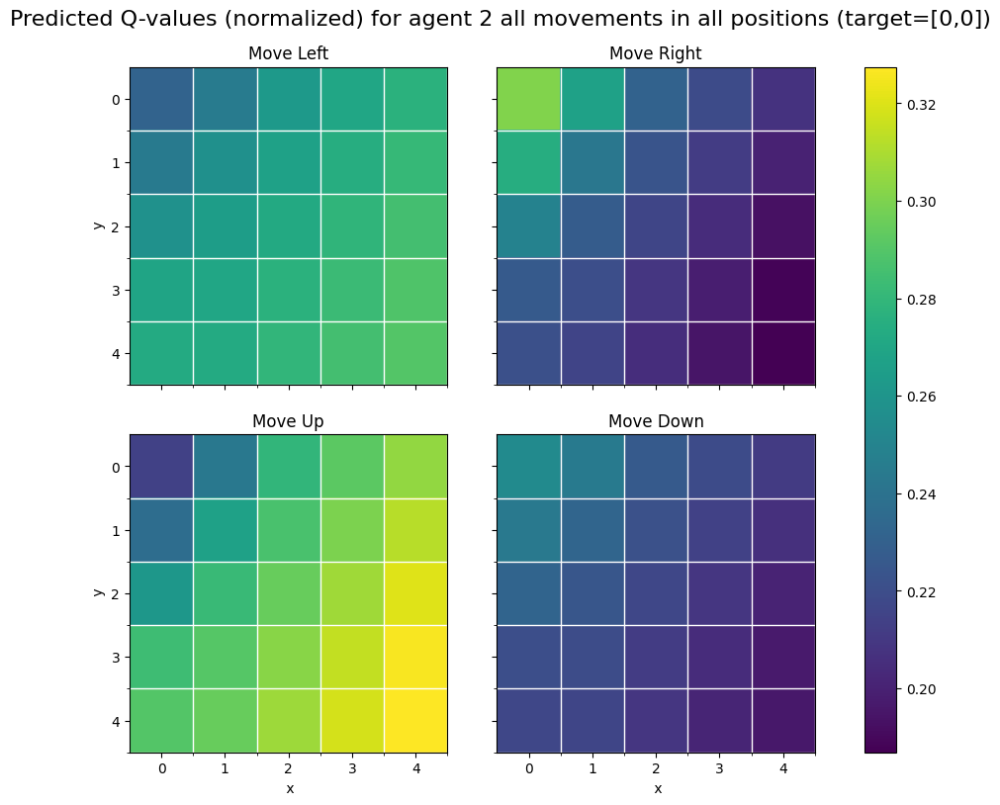

In [11]:
# Type II agent's policy when Type I agent is at [0, 0]
Visualization.plot_move_qvals_per_state(learning_2.table, env_2, target=LOC_A, has_item=False,
                                        agent_type=EnvironmentElement.AGENT_TYPE_2)

#### Type II agent target: Location B
- For `MoveLeft`, q-values are low and bested by `MoveRight` and `MoveDown` in all scenarios.
- For `MoveRight`, q-values are high overall and this action is executed most of the times.
- For `MoveUp`, q-values are low and bested by `MoveRight` and `MoveDown` in all scenarios.
- For `MoveDown`, q-values are high overall but bested by `MoveRight` in all positions. This action is executed when `MoveRight` is not a possible move due to grid boundaries.

Note: for diagonals, the optimal move is either `MoveRight` followed by `MoveDown` or vice versa as Type II agent aims at a fixed location B at the bottom-right corner of the grid. Hence, the target is always on the bottom-right of Type II agent. This also explains the above observation of high q-values for `MoveRight` and `MoveDown` actions.

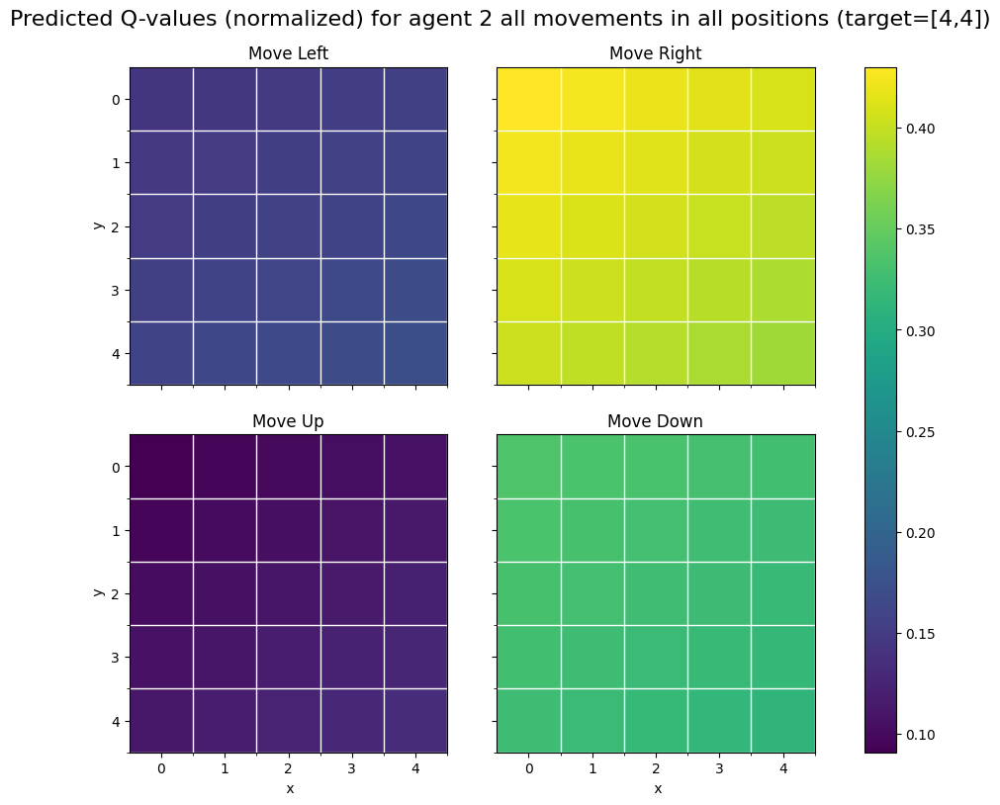

In [12]:
# Type II agent's policy when target is location B
Visualization.plot_move_qvals_per_state(learning_2.table, env_2, target=LOC_B, has_item=True,
                                        agent_type=EnvironmentElement.AGENT_TYPE_2)

### **Policy Visualization**

To visualize the policy, for a particular episode, we plot only the direction (action) with the highest q-value, $Q(s, a)$, learnt by the model so far, given the state. With this we can get a comprehensive overview of the best actions for each possible state. 

Note that due to the changing locations of agents, the policy would vary for different configurations.

Regardless as you can see from the plots below, for every grid cell, the best suggested action will always bring the agent closer to the target for both location A and B as described in the heatmap above, showing not only that our model has clearly learnt the task very well but also that it has sufficiently explored all the states when their targets are static.

However, when the target is not a fixed position like location A and B but a movable agent, we use a random position as the target. For these dynamic targets, we note that the policy learnt by the agent would not be targetting to the target but rather heading to the nearest handoff point which matches the policy of the target agent. Based on the learnt policy, we note that the learning is still not yet completed and more states should be explored to stabilize and solidify the policy.

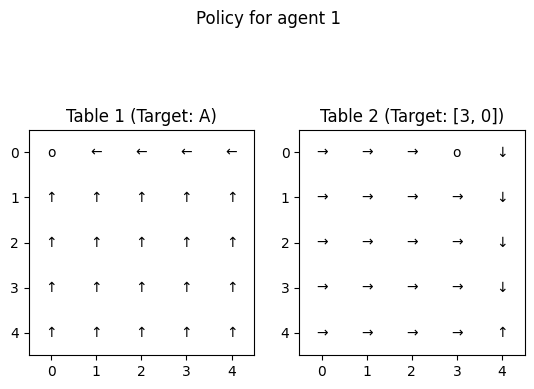

In [13]:
Visualization.plot_policy(env_2, learning_1, history_2, agent_type=EnvironmentElement.AGENT_TYPE_1)

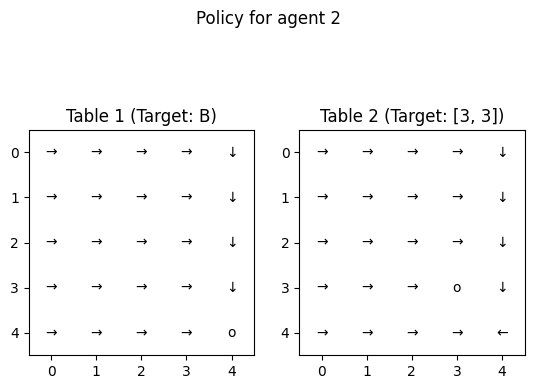

In [14]:
Visualization.plot_policy(env_2, learning_2, history_2, agent_type=EnvironmentElement.AGENT_TYPE_2)

### **Path Visualization**

To visualize the learning progress, we plot the path taken by the agent in a random run in the first evaluation episode and then a random run from the episode with lowest evaluation loss. 

As you can see in the first episode, the agents will most likely get stuck moving back and forth over a small area, this is because during evaluation our target policy completely exploits the learnt Q network. Since in the first episode it hasn't learnt much of anything, getting stuck is to be expected.

However in the best episode, the agents performs impressively by executing the shortest path to first pick up item at A then go to the handover point (Type I agent) or first go to handover point and then deliver item to point B (Type II agent)! This concretely shows the progress that has been made between the first and chosen evaluation episodes.

The plot is designed using interactive HTML environment so that it can animate the actions made by the agent sequentially to trace the path taken by the agent. 

Controls:
- Press the `>` button to move the animation forward
- Press `<` to reverse the animation
- Press the `+` button to speed up animation
- Press the `-` button to slow down animation
- You can manually slide the slider to move to specific frames/states

*Note: you can re-run the code block below to get a different random first and chosen evaluation episode*

*Note: since the agent path animation chooses a random evaluation configuration from the last episode it may not be the same one as the policy plot*

In [15]:
Visualization.plot_first_and_custom_path_eval(eval_history_2, best=True)

### **SmoothL1Loss Graph**

Below shows the loss graph for the SmoothL1Loss used to train the deep-q network.

*NOTE: THIS GRAPH IS DIFFERENT FROM THE CUSTOM METRICS (L1, L2 Losses) WE DESIGNED AND IS NOT A GOOD INDICATOR OF HOW WELL THE AGENT PERFORMS THE TASK*

This loss simply shows the average difference between the predicted Q-value from the prediction network and the reward + predicted Q-value from the target network. Since both networks are learning throughout training, this graph is a better indicator of convergence. As you can see the spikes in losses are quite drastic in the beginning due to very different projections between target and prediction network, however at the end you can see that the fluctuations are much tamer showing that the prediction and target network's outputs are very close.

Also, note that the training for Type II agent is highly unstable as compared to Type I agent. This is mainly due to the fact that goal of Type II agent is fully dependent on its dynamic target (Type I agent). As Type I agent is exploring and learning the environment, Type II agent has to try to match its policy with that of Type I agent which is highly dynamic. With that, the learning of Type II agent is highly unstable as depicted in the graph on left-hand side.

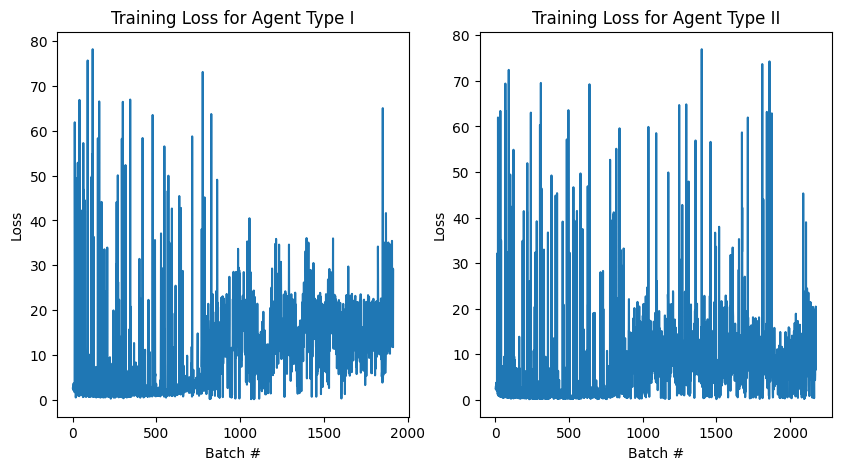

In [16]:
Visualization.plot_training_loss(engine_2)

### **State & Q-Values Visualization**

To find how important a position $p$ is, we will show the average Q-Values corresponding to the actions from adjacent positions that lead to $p$.

Similar to the q-value visualisation, we would have to analyze it based on the type of agents and their respective target. As you can see below, the predictions are sensible.

#### Type I agent with target: Location A

From the visualisation below, as expected, the most important position is [0,0] which is the target itself and its directly adjacent positions [0,1] and [1,0] which are only 1 move away from the target. This clearly shows that the type I agent has learned very well and heads to the top-left corner to pick up the item at location A.

Consequently the positions that are far away from [0,0] such as the far right or far bottom of the grid has the lowest Q-values as many moves are required to reach [0,0] from those positions.


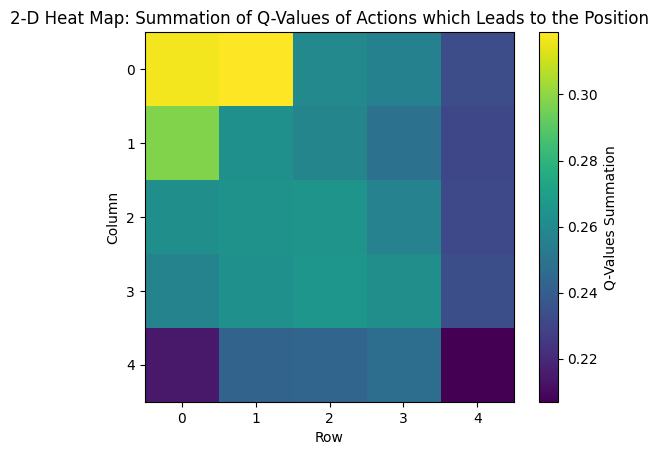

In [42]:
# Type I agent targetting location A
Visualization.plot_q_values(learning_1, target=LOC_A, has_item=False, proj="2D")

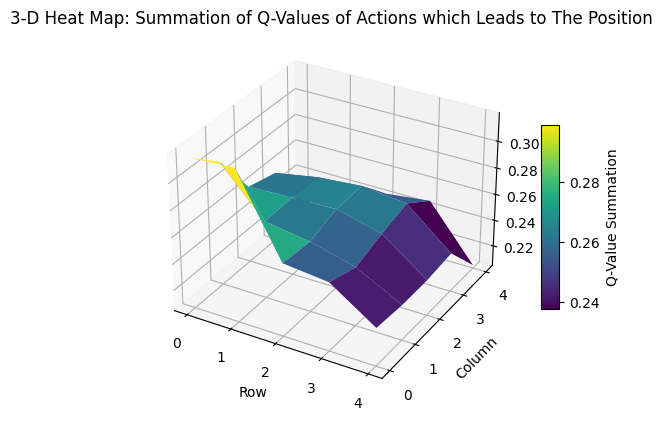

In [43]:
# Agent I aiming at location A
Visualization.plot_q_values(learning_1, target=LOC_A, has_item=False, proj="3D")

#### Type I agent with target: Type II agent at [2, 1]

From the visualisation below, we notice that the adjacent grids to the position [1, 1] and [2, 0] have particularly high Q-values. In particular we note that [2,1] itself does not have a very high Q-value which again reinforces the idea that instead of targetting the current position of the type II agent, since the target is dynamic, we expect it to move, and thus the model actually prioritizes moving towards an efficient handover point **between** its current location and its dynamic targets present location. [3, 1] has a lower Q-value compared to [1,1] and [2,0] because after the Type I agent picks up the item, it should be at A ([0,0]) and thus, the ideal handover point should be between [0,0] and [2, 1].

*Note that although [4,4] has a very high Q-value during training type I agents rarely actually reach [4,4] and this is more of an indication that the model favours moving right compared to left (notice that the entire first column has very low Q-values).*

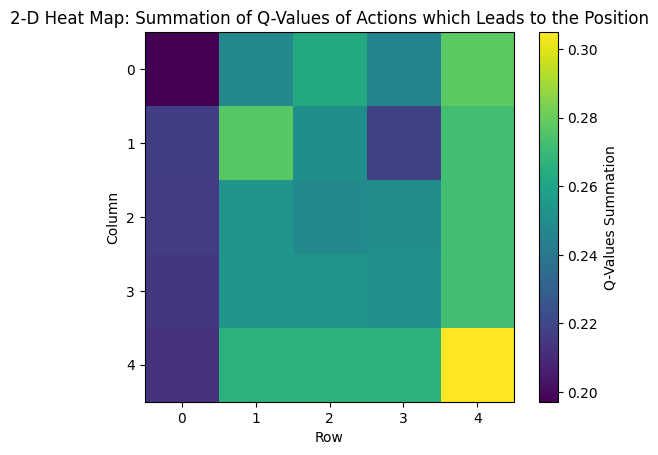

In [46]:
# Type I agent aiming at Type II agent at [2, 1]
Visualization.plot_q_values(learning_1, target=[2, 1], has_item=True, proj="2D")

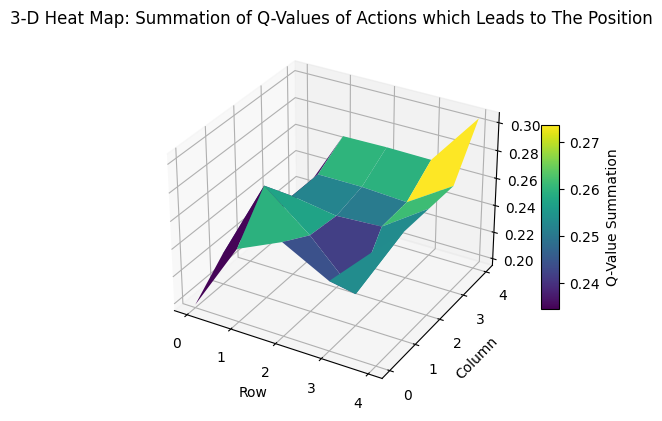

In [47]:
# Type I agent aiming at Type II agent at [2, 1]
Visualization.plot_q_values(learning_1, target=[2, 1], has_item=True, proj="3D")

#### Type II agent with target: Type I agent at [0, 0]

From the visualisation below, we notice something interesting which is that [0,0] actually doesn't have the highest Q-value but instead its nearby positions within 1-2 steps have the highest Q-values. This is again because for this stage, the type I agent is a dynamic target, and thus is expected to move from [0,0] where they picked up the item to one of its adjacent cells. Thus, the model prioritizes moving the type II agent to an efficient handover point between its current position and [0,0]. Notice that the top-left side of the board has higher Q-values compared to the bottom-right since the bottom-right portion never holds the most efficient handover point.

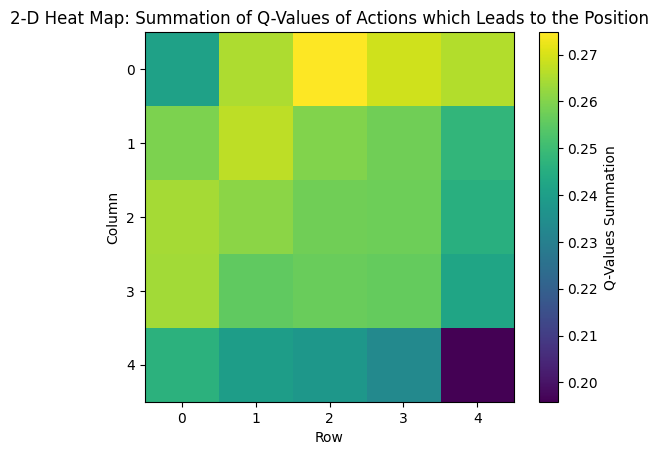

In [48]:
Visualization.plot_q_values(learning_2, target=LOC_A, has_item=False, proj="2D")

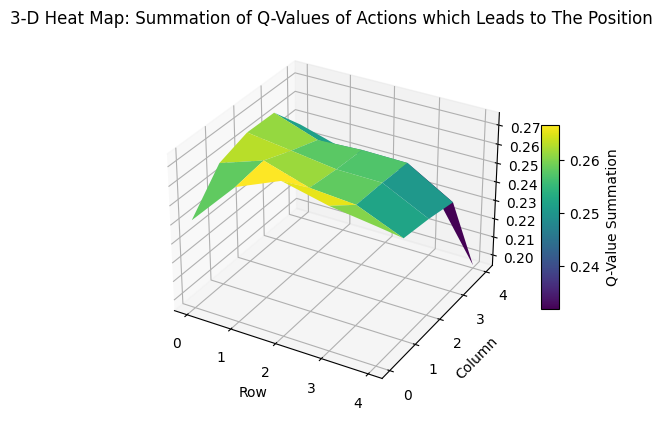

In [49]:
Visualization.plot_q_values(learning_2, target=LOC_A, has_item=False, proj="3D")

#### Type II agent with target: Location B

From the visualisation below, as expected, the most important position is [4,4] which is the target itself and its directly adjacent positions [3,4] and [4,3] which are only 1 move away from the target. This clearly shows that the type II agent has learned very well and heads to the bottom-right corner to deliver the item to location B.

Consequently the positions that are far away from [4,4] such as the far left or far top of the grid has the lowest Q-values as many moves are required to reach [4,4] from those positions.

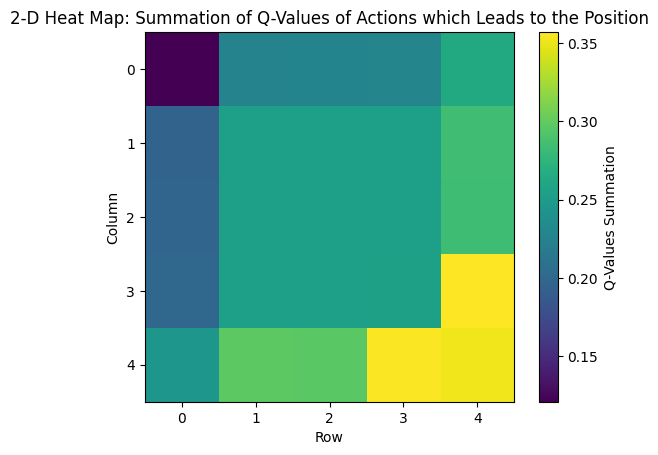

In [50]:
Visualization.plot_q_values(learning_2, target=LOC_B, has_item=True, proj="2D")

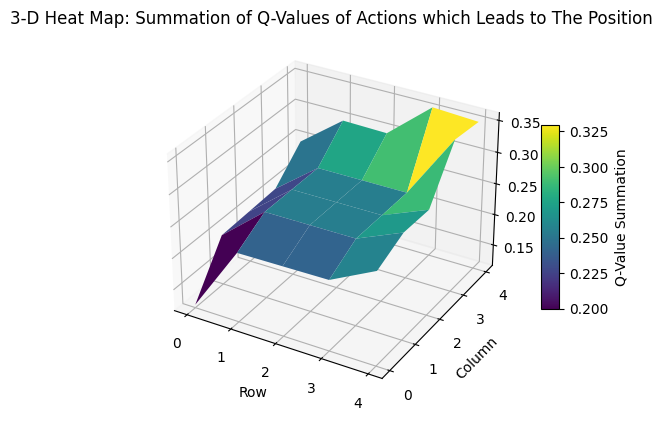

In [51]:
Visualization.plot_q_values(learning_2, target=LOC_B, has_item=True, proj="3D")

## Dueling

In order to improve the instability and low convergence problems in DQN, various techniques have been applied. Among them, we have chosen to experiment with Dueling DQN architecture.

The idea of dueling network is intuitive such that it is not necessary to estimate the value of each action choice. Building on top of the concept, another stream (branch) is added to DQN for estimating the advantage function value which later combined with the value estimation by another stream to obtain the final Q-value.

The idea could be expressed mathematically as follows.

\begin{equation*}
    Q^{\pi}(s) = V^{\pi}(s) + A^{\pi}(s)
\end{equation*}

where $V^{\pi}(s)$ is the state-value function of $s$ and $A^{\pi}(s)$ is the advantage function of $s$ which measure the relative importance of each action. Since

\begin{equation*}
    V^{\pi}(s) = \mathbb{E}_{a\sim \pi(s)}[Q^{\pi}(s,a)]
\end{equation*}

It follows that $\mathbb{E}_{a\sim \pi(s)}[A^{\pi}(s,a)] = 0$. For a deterministic policy, $a^* = \arg\max_{a'\in A}Q(s, a')$, it follows that $Q(s,a^*) = V(s)$ with $A(s, a^*) = 0$.

However, follow the above equation would produce an unidentifiable result such that given $Q$, we cannot recover $V$ and $A$ uniquely. To see why, adding a constant $c$ to $V$ and $-c$ to $A$ would result in the same $Q$ value. This lack of identifiability is poor. To address this issue, the advantage function of chosen action is forced to be 0, resulting in the following equation.

\begin{equation*}
    Q(s, a; \theta, \alpha, \beta) = V(s; \theta, \beta) + (A(s, a;\theta,\alpha) - \max_{a'\in |A|} A(s, a';\theta,\alpha))
\end{equation*}

With the above equation, we have $V(s;\theta,\beta)$ provides an estimate of the value function while $A(s, a';\theta,\alpha)$ provides an estimate of the advantage function. However, the update is yet a stable estimator and hence is replaced by the following equation for stable training.

\begin{equation*}
    Q(s, a; \theta,\alpha,\beta) = V(s;\theta,\beta) + (A(s, a;\theta,\alpha) - \frac{1}{|A|}\sum_a'A(s, a';\theta, \alpha))
\end{equation*}

Note subtracting mean in the above equation helps with identifiability and also preserves any greedy or $\epsilon$-greedy policy based on Q values from original equation. Overall, the update is similar with DQN with an extra weights to be updated for double-streams architecture. 

For implementation purpose, please refer to the following relevant class.
- `Dueling` (A class for implementing the Dueling architecture design) located [**here**](modules/model.py)

In [25]:
# Dueling with absolute positions
env_3, history_3, eval_history_3, engine_3 = init_training(grid_size=GRID_SIZE, loc_a=LOC_A, loc_b=LOC_B, 
                                                           update_intervals=(175, 325), mode="absolute_positions", 
                                                           gamma=0.9, tau=0.5, lr=0.01, double=False, dueling=True)

In [26]:
best_learnings_3 = engine_3.run()

New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 3
loc: [1, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [1, 1], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 2
loc: [0, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [0, 3], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [3, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 1], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
handover between Type: 2 agent index: 2
loc: [0, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [

New episode
handover between Type: 2 agent index: 3
loc: [2, 0], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 0], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
New episode
New episode
New episode
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
handover between Type: 2 agent ind

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [1, 0], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [1, 0], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [2, 0], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 0], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [1, 1], target pos: [4, 4], target elem

New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New 

New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [3, 0], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 0], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
handover between Type: 2 agent index: 2
loc: [1, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [1, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 3
loc: [2, 0], target pos: [4, 4

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 2
loc: [1, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [1, 1], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
handover between Type: 2 agent index: 2
loc: [4, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4,

New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 3
loc: [3, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 

New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
Found new best model with average loss: 3918.84850 < previous lowest eval loss: 4946.47650
Found new best model with average loss: 3918.84850 < previous lowest eval loss: 4946.47650
=====EVALUATION AT EPISODE 400: REWARD=-20364.1945=====
====EVALUATION AT EPISODE 400: LOSS=L1_Loss, VALUE=(11.128, 99.8, 99.802, 99.8)=====
====EVALUATION AT EPISODE 400: LOSS=L2_Loss, VALUE=(1100.256, 9980.0, 9980.002, 9980.0)=====
New episode
handover

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [0, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [0, 3], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 3
loc: 

New episode
handover between Type: 2 agent index: 3
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 3
loc: [1, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [1, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 1], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 ag

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
handover between Type: 2 agent index: 2
loc: [2, 1], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [2, 1], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 3
loc: [0, 0], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [0, 0], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent i

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 2
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], 

handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
New episode
handover between Type: 2 agent index: 2
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfull

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succes

handover between Type: 2 agent index: 3
loc: [3, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3,

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [1, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [1, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [1, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [1, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [2, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3


handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [2, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 3], target pos: [0, 0], tar

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [2, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [2, 3], target pos: [0, 0], tar

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [2, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [2, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], tar

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4],

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Found new best model with average loss: 4.30000 < previous lowest eval loss: 4.39350
Found new best model with average loss: 4.30000 < previous lowest eval loss: 4.39350
=====EVALUATION AT EPISODE 800: REWARD=75.208=====
====EVALUATION AT EPISODE 800: LOSS=L1_Loss, VALUE=(0.072, 3.9, 3.266, 0.0)=====
====EVALUATION AT EPISODE 800: LOSS=L2_Loss, VALUE=(0.144, 15.956, 11.062, 0.0)=====
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [0, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [0, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
l

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: 

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4],

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4,

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], tar

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: 

New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
New episode
handover between Type: 2 agent index: 2
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: Tru

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], targ

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4],

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], targ

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
New episode
handover between Type: 2 agent index: 3
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], 

New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True a

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [

New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New epis

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], tar

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], targ

handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True a

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], tar

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

handover between Type: 2 agent index: 3
loc: [3, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target 

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], tar

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 age

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], tar

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], ta

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New epis

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], targ

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 2], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New epis

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 2],

New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent inde

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 age

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], tar

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], ta

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
=====EVALUATION AT EPISODE 2200: REWARD=98.833=====
====EVALUATION AT EPISODE 2200: LOSS=L1_Loss, VALUE=(0.076, 4.956, 4.32, 0.0)=====
====EVALUATION AT EPISODE 2200: LOSS=L2_Loss, VALUE=(0.152, 25.176, 19.176, 0.0)=====
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover betwee

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4

New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc:

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Typ

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has it

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delive

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
lo

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
Ne

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 

handover between Type: 2 agent index: 2
loc: [4, 2], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 2], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], tar

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1

Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to

New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfull

New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfull

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4,

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], ta

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Typ

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4

Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has i

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 

New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 3],

Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4],

Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: Fa

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Typ

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered 

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Ty

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], tar

Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4

handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], ta

Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: 

handover between Type: 2 agent index: 2
loc: [4, 3], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 3], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
Finish episode!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], tar

handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 1
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
Finish episode!
New episode
handover between Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [4, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
handover between Type: 2 agent index: 2
loc: [3, 4], target pos: [4, 4], target elem: [4, 4], has item: True and Type: 1 agent index: 0
loc: [3, 4], target pos: [0, 0], target elem: [0, 0], has item: False
Type: 2 agent index: 2
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item:

New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
Type: 2 agent index: 3
loc: [4, 4], target pos: [4, 4], target elem: [4, 4], has item: True succesfully delivered to B!
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New episode
New 

In [27]:
learning_3_1, learning_3_2 = best_learnings_3

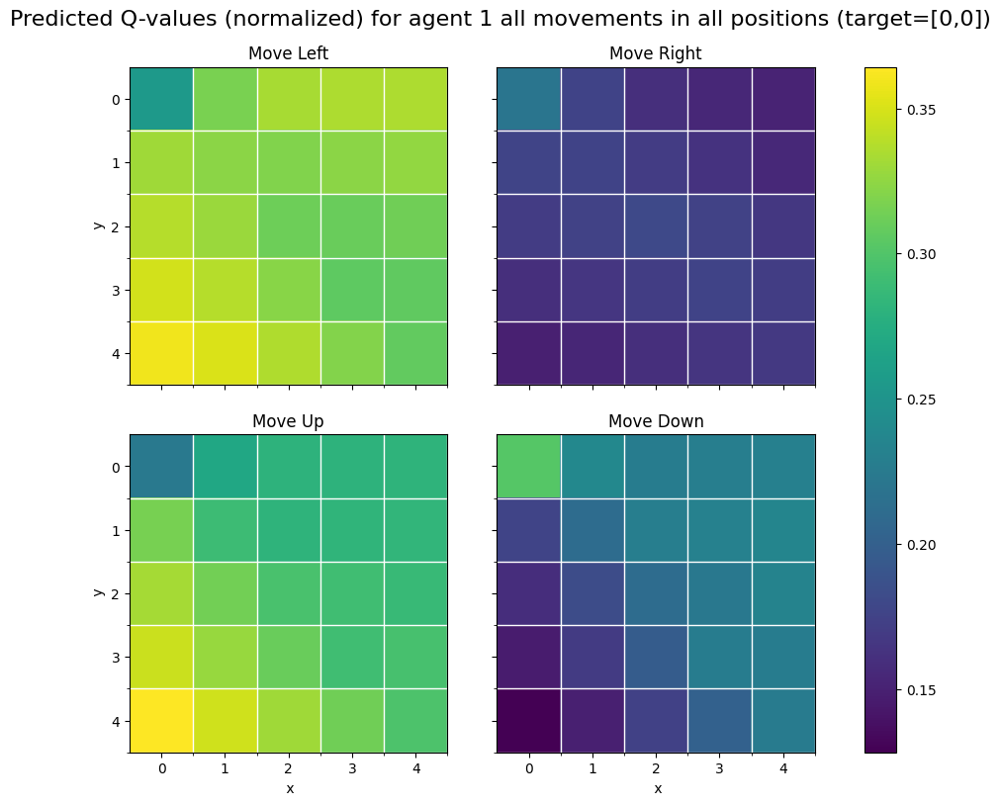

In [28]:
# Type I agent's policy to location A
Visualization.plot_move_qvals_per_state(learning_3_1.table, env_3, target=LOC_A, has_item=False)

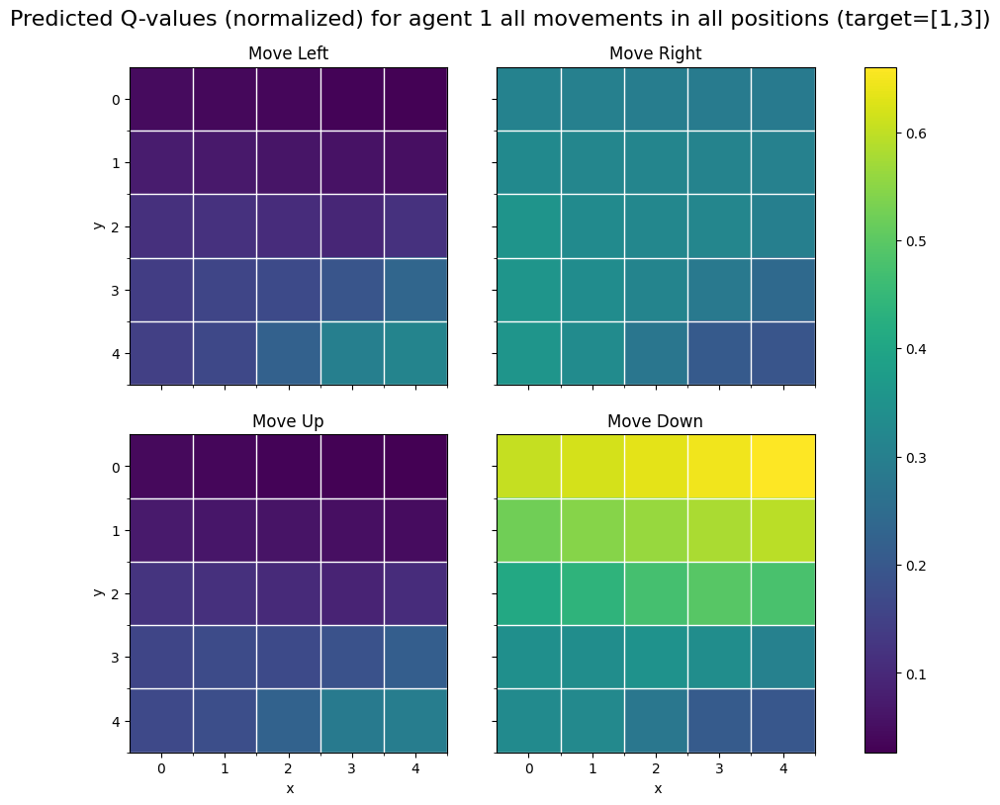

In [29]:
# Type I agent's policy to Type II agent at [1, 3]
Visualization.plot_move_qvals_per_state(learning_3_1.table, env_3, target=[1,3], has_item=True,
                                        agent_type=EnvironmentElement.AGENT_TYPE_1)

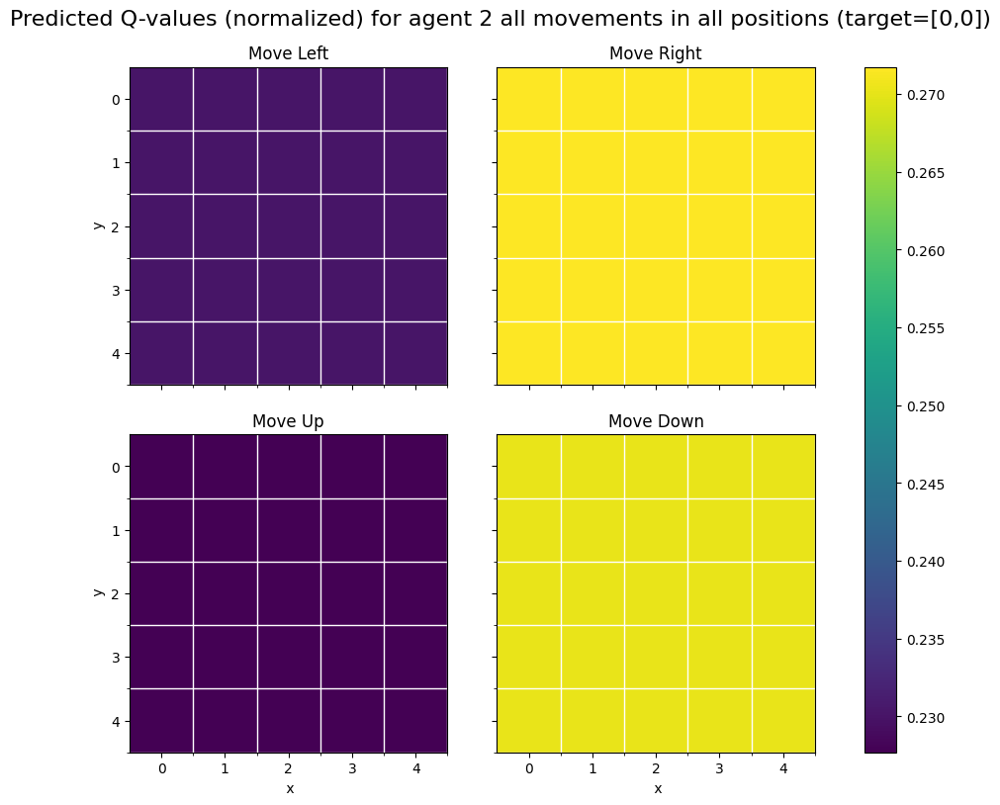

In [30]:
# Type II agent's policy when Type I agent is at [0, 0]
Visualization.plot_move_qvals_per_state(learning_3_2.table, env_3, target=[0, 0], has_item=False,
                                        agent_type=EnvironmentElement.AGENT_TYPE_2)

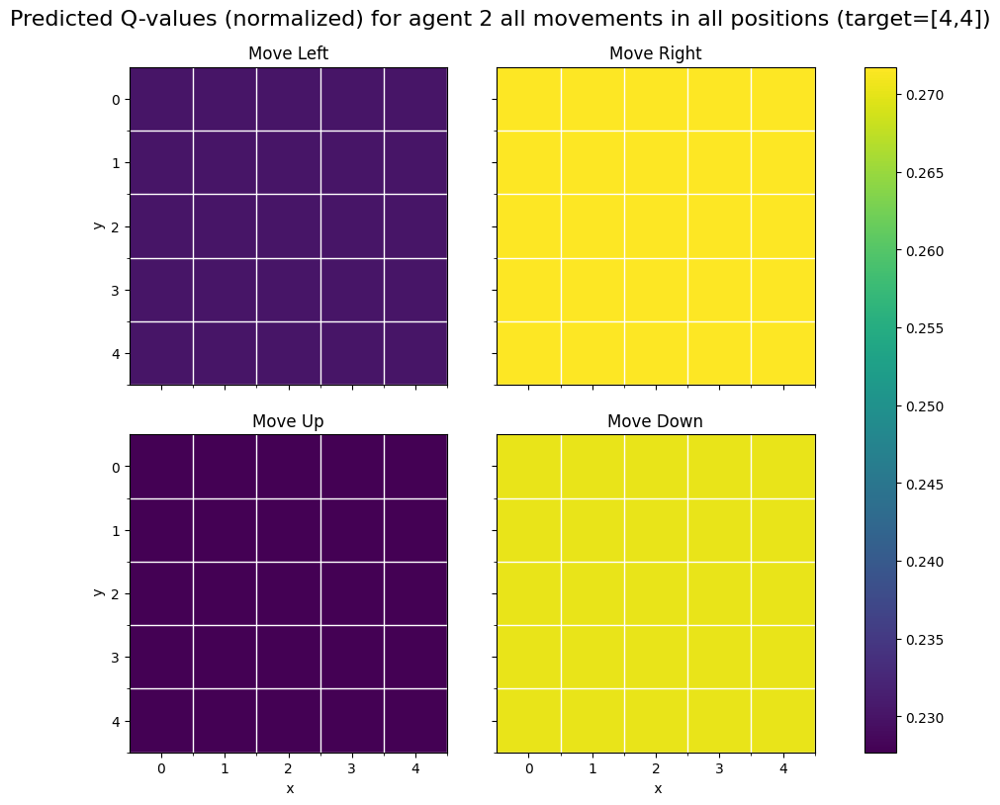

In [31]:
# Type II agent's policy when target is location B
Visualization.plot_move_qvals_per_state(learning_3_2.table, env_3, target=LOC_B, has_item=True,
                                        agent_type=EnvironmentElement.AGENT_TYPE_2)

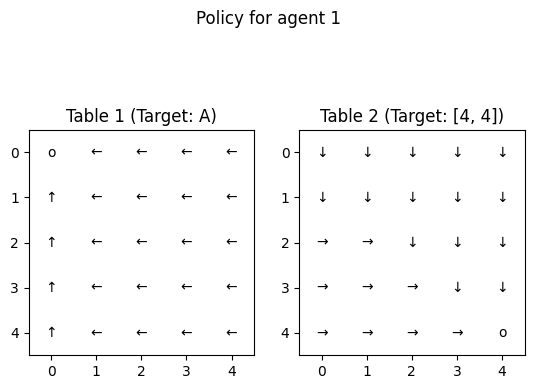

In [32]:
# Policy of Type I agent
Visualization.plot_policy(env_3, learning_3_1, history_3, agent_type=EnvironmentElement.AGENT_TYPE_1)

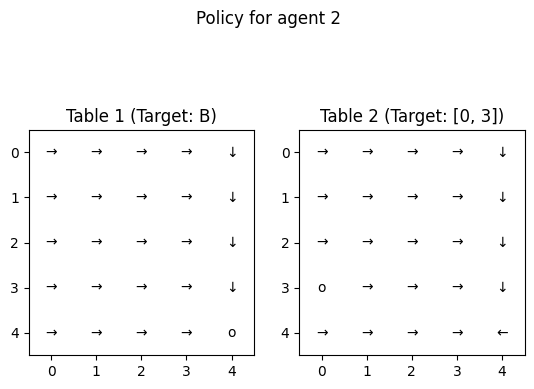

In [33]:
# Policy of Type II agent
Visualization.plot_policy(env_3, learning_3_2, history_3, agent_type=EnvironmentElement.AGENT_TYPE_2)

In [34]:
# Animate Selected Episode
Visualization.plot_first_and_custom_path_eval(eval_history_3, best=True)

###  **Loss Graphs (Training)**

To visualize the performance of our model over time, we plot the losses over the number of episodes as a line graph. 
Note: these are the custom L1 and L2 losses (NOT the SmoothL1Loss used for training the Deep Q-Network) which directly assesses model performance in reaching the target via the least number of steps

Note: the spikes in losses are due to the moving goalpost when weights of prediction network is copied over to target network, importantly you can see that the spikes in losses decrease as training progresses and eventually loss converges to 0, which proves that our model is learning

We note that although the original Deep-Q method had higher average losses in earlier batches, after its loss decreased to 0, regardless of moving goalpost, no more loss spikes were seen showing that it converged stably. On the other hand, Dueling method had lower average losses in the beginning but experienced larger spikes later on showing instability for this particular hyperparameter configuration.

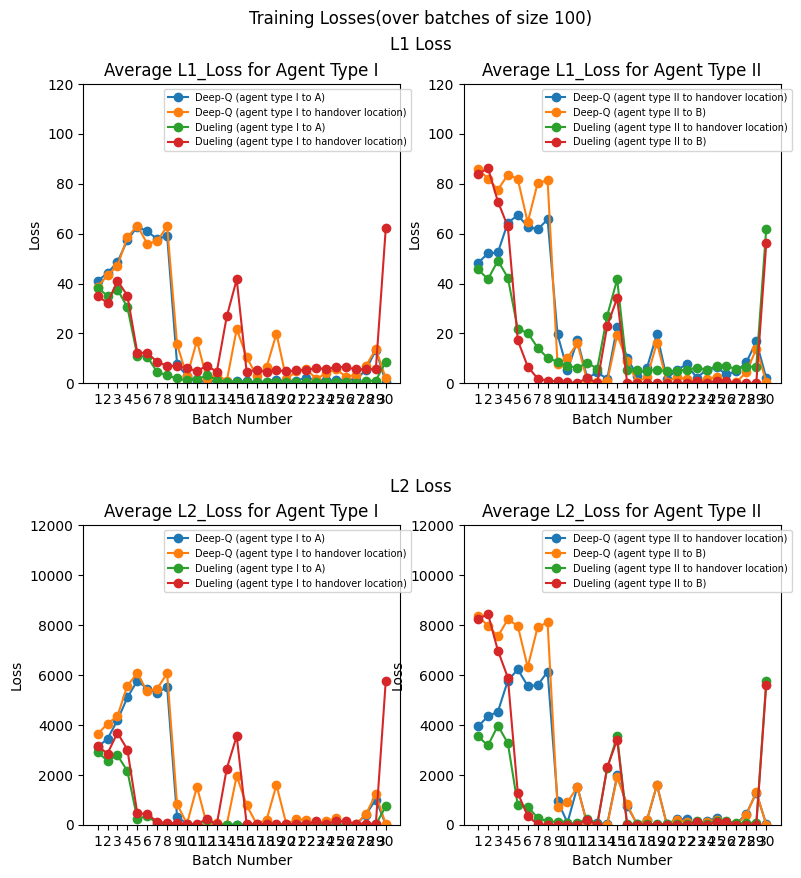

In [35]:
model_histories = {
    "Deep-Q": history_2,
    "Dueling": history_3
}

Visualization.plot_losses(model_histories)

### **Loss Graphs (Evaluation)**

To visualize the performance of our model over time, we plot the losses over the number of episodes as a line graph. 
Note: these are the custom L1 and L2 losses (NOT the SmoothL1Loss used for training the Deep Q-Network) which directly assesses model performance in reaching the target via the least number of steps

Note: the spikes in losses are due to the moving goalpost when weights of prediction network is copied over to target network, importantly you can see that the spikes in losses decrease as training progresses and eventually loss converges to 0, which proves that our model is learning

We note that although the original Deep-Q method had higher average losses in earlier batches, after its loss decreased to 0, regardless of moving goalpost, no more loss spikes were seen showing that it converged stably. On the other hand, Dueling method had lower average losses in the beginning but experienced larger spikes later on showing instability for this particular hyperparameter configuration.

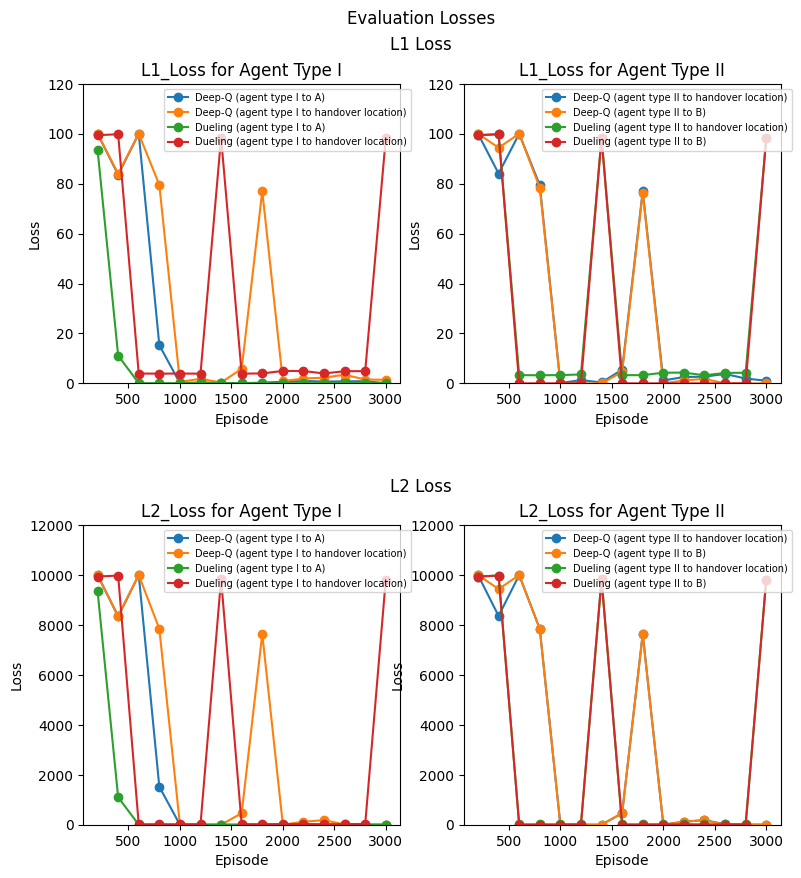

In [36]:
model_histories = {
    "Deep-Q": eval_history_2,
    "Dueling": eval_history_3
}

Visualization.plot_losses(model_histories, train=False)

## Hyper-parameter Testing

Here we perform hyper-parameter testing to show that our solution is adaptive to many different parameter values.
In particular, here we train and evaluate a model for every combination of the following sets of hyperparameters:
- learning_rates = [0.01, 0.001]
- gammas = [0.1, 0.9]
- taus = [0, 0.5, 0.9]
- doubles = [True, False]
- update_intervals = [(150, 250), (175, 325), (200, 375)]

After training and testing all these models, the top 5 models (determined by minimum average evaluation loss as well as speed to convergence) are plotted below.

*Please note that running the following code cell will take upwards of 6 hours depending on your computing power and resources.*

For more details, please refer to the implementation:
- `hyperparam_search` (function to perform hyperparameter testing which will train and evaluate each model) located [**here**](modules/search.py)

**<span style="color:red">DISCLAIMER</span>**

Running the following cell is both memory and power demanding. From our testing, a gaming laptop with 12 GB free RAM for running the following cell would take 6-7 hours with both CPU and RAM usage of about 95%. Other than that, using above suggested combinations of hyperparameters, there are a total of 72 models which makes up about 4.04 GB .pkl file for saving. On a low memory device, the analysis based on existing .pkl file is time-consuming due to memory-demanding operation. Only run the following cell when you have strong laptop or PC.

Notably, to reduce the CPU and RAM usage, fewer combinations could be used instead of the default settings. However, it requires you to modify the code directly as those hyperparameters are set manually in the code.

*Note: Moodle does not allow submission of 4.04GB file. In order to ease the submission and marking process, we have prepared a trimmed version file which stores only the top-5 models from the hyperparameter testing results. Running the subsequent cell after the following cell would give you better experience in running this notebook.*

In [37]:
# Uncomment the line below to start the testing
# hyperparam_search(save_to="hyperparam_search_res.pkl")

# Uncomment the line below if you have previous result available
# hyperparam_search(load_from="hyperparam_search_res.pkl")

For graph readability, the combinations of hyperparameters are not shown in the legend of the graph. For your reference, the combinations are included as follow.

- Top 1
    - Learning Rate = 0.001
    - Gamma = 0.9
    - Tau = 0.5
    - Double = False
    - Update Interval = (200, 375)
- Top 2
    - Learning Rate = 0.001
    - Gamma = 0.1
    - Tau = 0.9
    - Double = True
    - Update Interval = (200, 375)
- Top 3
    - Learning Rate = 0.001
    - Gamma = 0.9
    - Tau = 0.5
    - Double = False
    - Update Interval = (150, 250)
- Top 4
    - Learning Rate = 0.01
    - Gamma = 0.1
    - Tau = 0
    - Double = False
    - Update Interval = (200, 375)
- Top 5
    - Learning Rate = 0.001
    - Gamma = 0.1
    - Tau = 0
    - Double = True
    - Update Interval = (175, 325)
    
Note that even though using update interval of (175, 325), the convergence rate would be slower, it does not fluctuate much once it's converged. This is because the update of target network in both kind of agents could match with each other policy. Other than that, it is noted that the spike after convergence is contributed by Type II agent not reaching location B. This is best explained using the updates in the weights of target network, resulting in instability in the prediction.

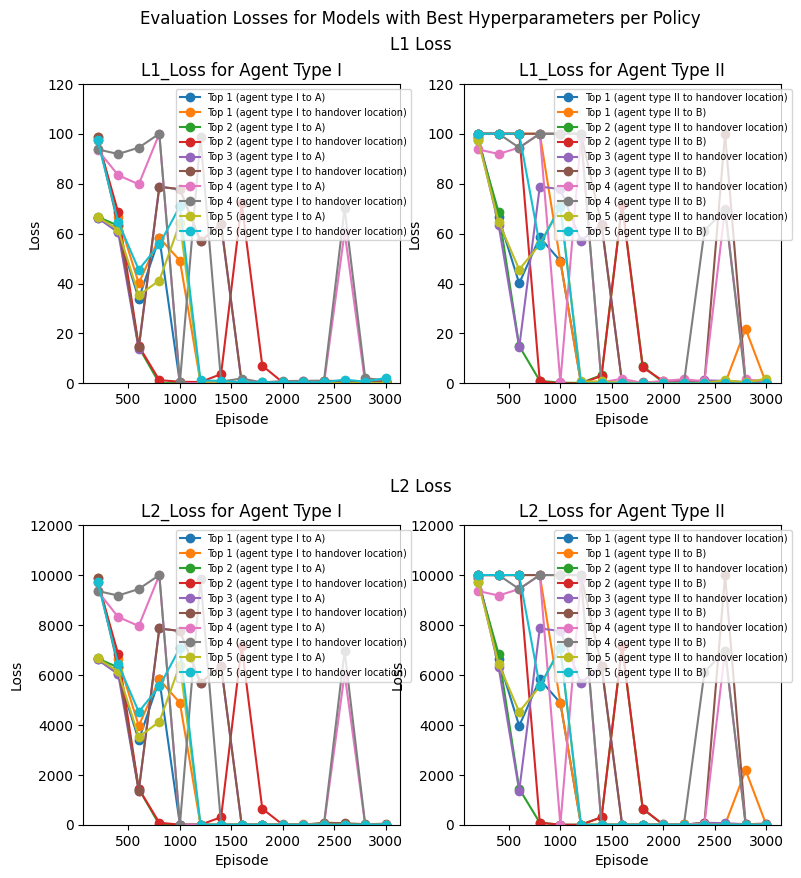

In [38]:
hyperparam_search(load_from="hyperparam_search_res_trim.pkl")

## Grid Size Testing

To show that our solution is adaptable to different sized grid worlds, below we have trained a separate model for the following grid world sizes:
- (3,3)
- (5,5)
- (6,6)

Finally, we plot the losses for all 3 grid sizes and as expected, the larger the grid world the more the initial loss, and the slower the convergence, although there is a clear downward trend in all the grid worlds, proving that our method clearly learns even with different grid sizes.

*NOTE: we found that the update_interval is very important in determining convergence speed, the larger the grid world, the larger the update_interval needs to be in order for the model to converge, especially for Type II agent. This makes sense because if the grid world is large, the prediction network should get the chance to explore many situations and update many times to reach a stable state before copying its weights over to the target network, otherwise we might run into situations where we are moving the goal post to a bad position which is difficult to recover from. On the other hand, the first task of Type II agent is to meet Type I agent at handover point which is dynamic based on the behaviours of Type I agent. Similarly, the prediction network should explore numerous scenarios to reach a stable state.*

For 3x3 grid worlds, the agent learns quickly and the loss stays near 0, for larger sized grid worlds we see that the loss reaches near 0 as well, typically at a slower rate but that there are large spikes due to moving goalpost (these spikes are larger for larger gridsizes), though they all eventually converge, showing that our model is generalizable to different grid worlds.


For more details, please refer to the implementation:
- `test_grids` (function to perform model training and evaluation on different grid sizes) located [**here**](modules/grid_test.py)

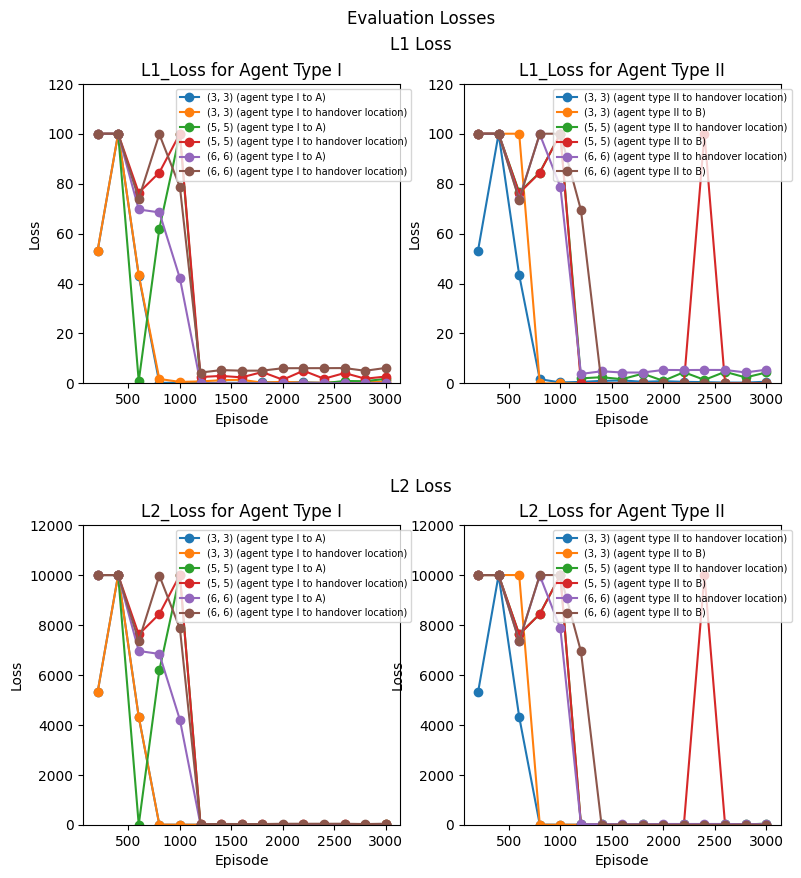

In [39]:
# Uncomment the line below to start the testing
# results_grid = test_grids(save_to="grid_test.pkl", verbose=1)

# comment the line below if no previous results available
results_grid = test_grids(load_from="grid_test.pkl", verbose=1)

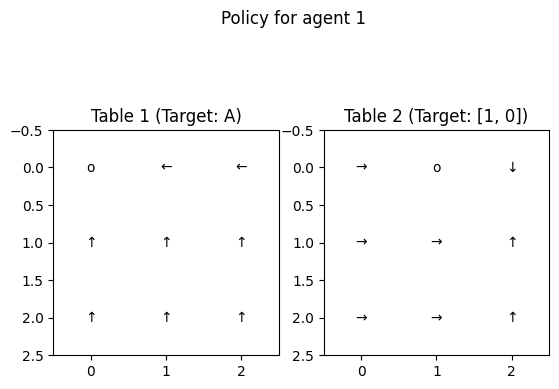

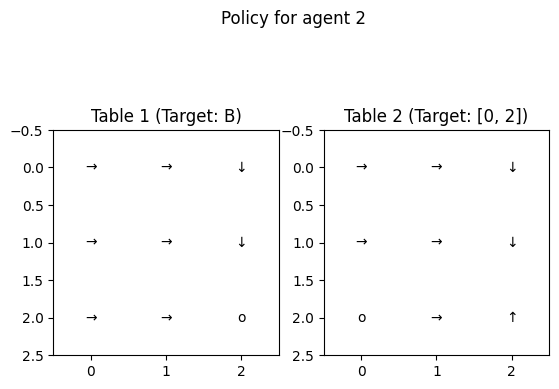

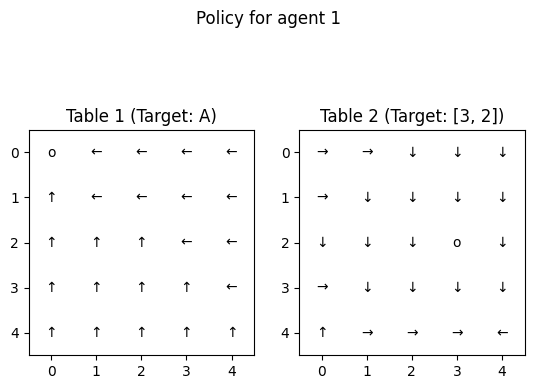

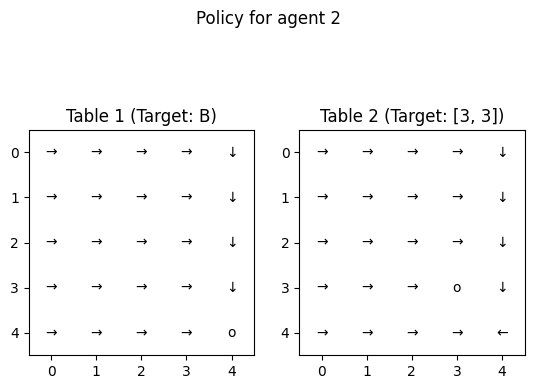

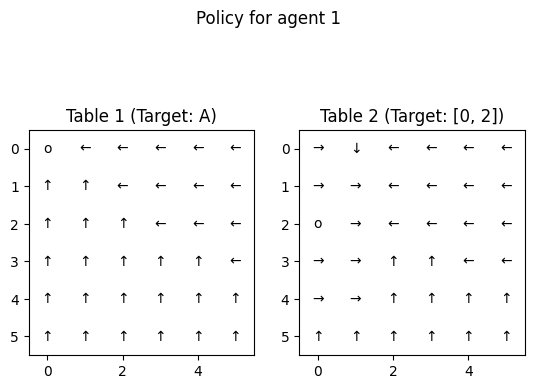

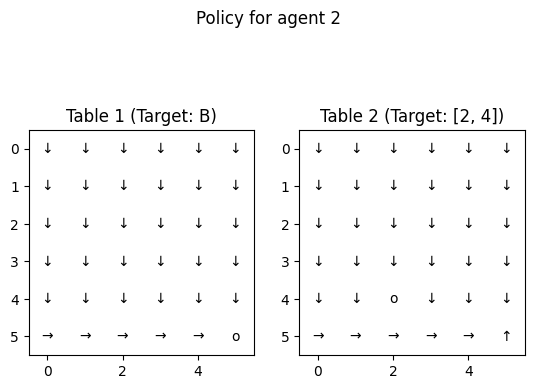

In [40]:
test_grids_viz(results_grid)

## Summary

In general, irrespective of the network architectures, the learning of the agent would converge eventually and produce a generalised policy for locating the ideal path to point A followed by handoff point and point B. However, a good choice of hyperparameters is essential in producing good results.

Since we randomly generate the positions of the agents, and in addition, during evaluation of performance we test for 500 randomly sampled (agents) positions, as can be seen by the decreasing losses and eventual convergence, we have proven that our solution is generalizable to any randomized agent positions.

During the early stages of training, it is observed that the agent's learned policy often contradicts itself, leading to an infinite loop as depicted in the path tracing plot above. This behavior is primarily due to the agent's limited understanding of the environment and its ongoing exploration to determine the best action given a particular state. Consequently, the agent is prone to getting stuck in an infinite loop while exhibiting minimal learning. To address this issue, which commonly arises in the initial evaluation phase, we have implemented a maximum step limit per episode. This limitation serves two purposes: firstly, it resolves the problem of infinite loops, and secondly, it guides the agent's learning process towards minimizing the number of steps taken. The effectiveness and practicality of this technique become evident after approximately 2000 episodes, where the agent successfully locates both point A, handoff point and B while taking the fewest possible steps.

The policy visualization provided above demonstrates that the agent's learned policy can be effectively applied to different positions of target including dynamic target. However, it will gets stuck in local optimum easily with dynamic target (other type of agent). By randomly sampling the locations of target based on the agent's learning history, we have observed that the policy consistently determines the optimal path to both points A and B as well as suboptimal path to handoff point, regardless of their specific positions. This adaptability is achieved by structuring the agent's understanding of states. Instead of using the raw position on the grid as the state, we represent the state using target position as well as a boolean indicator of having item, which creates an afterstate learning effect. This approach allows the agent to perceive the environment in a manner that can be reused across episodes. Through experimentation, we have demonstrated that this technique enhances the agent's learning process compared to a simple state space that relies solely on the use of Manhattan distance (which requires fine-tuning on hyperparameters to achieve similar performance). Such a representation of state enables the agent to learn more effectively and generate better policies.

Through the implementation of different techniques to structure the reward function, it has been observed that setting the TARGET REWARD to 1 and the BASE REWARD to -1 yields favorable results. However, by increasing the TARGET REWARD with quadratic penalty at each target point, the agent becomes more motivated to navigate towards points A and B as well as handoff point using shortest path. This leads to faster convergence, as demonstrated in the visualizations above. After approximately 2000 episodes, the target policy shows significant convergence and can be effectively applied to various grid configurations, as long as there is no overlap between the agents, point A, and point B. This adaptability of the policy allows for efficient navigation towards the desired points, further enhancing the overall performance of the agent.

Although the results presented above are promising, it is important to note a distinction between the single agent and multi-agent system. Unlike the single agent, the multi-agent system may lead the agents to become trapped in a local optimal policy after convergence, rather than achieving the global optimal policy that applies to all grid configurations. This realization comes from observing instances where the policy at certain grids does not align with the ideal path, resulting in a greater loss of reward. Notably, there are cycles of repetitive fluctuations in the evalution losses when a bad set of hyperparameters are selected. However, this behavior is acceptable considering the fundamental differences between the single agent and multi-agent system. In the multi-agent system, a single change in the neurons can have simultaneous effects on multiple states and actions, especially those involving collaboration with other types of agent. Additionally, the introduction of non-linearity in the network's structure leads to a loss function with a more complex surface curve, which can trap the optimization process in local optima when the policies learnt by different kinds of agent are highly overlapping.

Based on the loss plots, it is evident that the Dueling architecture achieves faster convergence compared to the standard Deep Q-Network (DQN) at early stage when using the same hyperparameter configurations. However, it should be noted that there are occasional spikes in the loss values during training, particularly in the Dueling architecture. These spikes can be attributed to the utilization of v-values to estimate q-values for each action. When the agent encounters experiences that have not been seen before, the estimation of q-values using v-values may be inaccurate, leading to higher loss values. Another potential factor contributing to the occasional spike in loss values is the synchronization of the target network with the prediction network. When the weights of the target network are updated to match those of the prediction network, the prediction of v-values can become unstable in relation to the new target, resulting in higher computed loss values. Nevertheless, both approaches ultimately converge with loss values approaching zero. It is worth noting that the standard DQN and Double DQN exhibits greater stability compared to the Dueling architecture under the tested configurations.

During the tests conducted on different grid sizes, it was observed that as the number of states increased proportionally with the grid size, the learning process became increasingly unstable. This instability can be attributed to the fact that a single neuron is responsible for handling a larger number of states, which scales with the total number of states in the grid. However, despite this initial instability, it was observed that the learning process eventually converged regardless of the grid size, as long as the hyperparameter configurations were set correctly. For instance, in the case of a grid size of (6, 6), it was found that a target network update interval of (225, 350) resulted in stable convergence. On the other hand, when the hyperparameter configurations were incorrect, such as in the case of a grid size of (5, 5), the learning process exhibited drastic fluctuations and struggled to accurately estimate the q-values. In summary, while larger grid sizes pose challenges in terms of stability due to the increased number of states assigned to each neuron, the learning process can still converge successfully with the appropriate hyperparameter configurations.

During the testing of hyperparameters, three main factors were identified as contributing to stable learning. Firstly, it was observed that using a soft-update approach with a high value of tau, such as 0.9, resulted in a more stable learning process. Soft-update involves proportionally updating the weights of the target network towards the weights of the prediction network, based on the value of tau. By having a smaller update in the weights of the target network, over-optimistic estimations that could lead to instability are avoided. Secondly, the utilization of a double Q-Network was found to enhance the stability of the training process. With a double Q-Network, the training process exhibited a stable decrease in loss values without experiencing sudden fluctuations. This stability is attributed to the unbiased estimator provided by the double Q-Network, which allows for a better approximation of the q-values. In summary, using a high tau value for soft-updates and implementing a double Q-Network both contribute to stable learning. These approaches help prevent over-optimistic estimations and provide an unbiased estimator, respectively, resulting in a more stable and reliable training process. Lastly, with good choice of network update intervals for different types of agents, the learning could be perfectly matching with each other, resulting in a stable learning.

In summary, our agents successfully learned the environment and generated a proficient policy for locating both point A, suboptimal handoff point and point B. However, to ensure adaptability to different environments, it is necessary to adjust the training configurations in order to achieve better stability and faster convergence in the learning process. This need for adaptability arises from the inherent instability of estimating an approximation of the target value using gradient descent methods. Although we tested various techniques to enhance stability and convergence rates, the learning process is still significantly influenced by the simplicity of the model architecture used in the experiment. Without the incorporation of any regularization techniques, the learning process lacks additional stabilization measures. Therefore, to further improve stability and convergence, it is recommended to explore the implementation of regularization techniques in the model architecture. This would help mitigate the instability associated with estimating target values and enhance the overall learning performance.

# 3. Game Theoretic Analysis

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

p1 = 0.25   # proportion of Agent 1 in the beginning

# The value are simply set to test the code if it runs
STRATEGY_1 = np.array([[0.25, 0.25, 0.25, 0.25]]).T
STRATEGY_2 = np.array([[0.25, 0.25, 0.25, 0.25]]).T

PAYOFF_1 = np.array([[20, 20, 30, 30],
                     [30, 30, 40, 40],
                     [40, 40, 50, 50],
                     [50, 50, 60, 60]])
PAYOFF_2 = np.array([[20, 30, 20, 30],
                     [40, 50, 40, 50],
                     [30, 40, 30, 40],
                     [50, 60, 50, 60]])


W1 = (STRATEGY_1.T @ PAYOFF_1 @ STRATEGY_1)[0][0]
W2 = (STRATEGY_2.T @ PAYOFF_2 @ STRATEGY_2)[0][0]

print('AVG_PAYOFF_1', W1)
print('AVG_PAYOFF_2', W2)

AVG_PAYOFF_1 40.0
AVG_PAYOFF_2 40.0


![payoff_matrix](img/game_theory_payoff.PNG)

**Type I vs. Type II Agents**

*Type I Agent:* Represents a higher-tier agent, optimized for efficiency and goal accomplishment. It often has the capability to swiftly locate targets and adapt to environmental changes, leading to higher payoff values.

*Type II Agent:* Represents a secondary agent that will achieve similar goals as Type I. While it can accomplish individual tasks, the payoff it gets for each goals will dominated by type I agent's strategy and payoff as it is dependant on type I agent's goal completion. In the presented matrix, we notice that the payoffs of Type II are frequently dominated by those of Type I. This design captures the inherent advantage of Type I agents, emphasizing their significance in completing tasks ahead of their Type II counterparts.

**Random policy** 

When an agent adopts a random policy, their actions lack any specific direction or intent. This randomness means the agent is navigating and making decisions arbitrarily without optimizing for a particular outcome. In the context of the given task, the agent might wander aimlessly, potentially overlooking A, B, or the other agent. As a result, a lot more time might be wasted, and there's no guarantee the agent will successfully complete the desired goals.

**Impact on Payoff**

The randomness inherently reduces efficiency, making tasks more time-consuming and uncertain in terms of outcome. Such a policy is generally associated with lower payoffs, as seen in the matrix. This serves as an implicit discouragement for agents to adopt a random strategy unless strategically necessary.

**Goal Representation**

The matrix cells correspond to scenarios where each agent have two primary goals:

Type I Agent: Find A, Find Agent II
Type II Agent: Find Agent I, Find B


**Payoff Values**

Payoff values in each cell are determined by two main factors:

*Task Completion:* Completing the tasks for example *Find A or B* or *Find Agent I or II* contributes positively to the payoff. However, the exact value depends on the efficiency and accuracy with which the task is completed.

*Time Taken:* Efficiency is key. The faster an agent can accomplish its goals, the higher the payoff. Conversely, taking too long may result in reduced payoffs due to inefficiencies or potential missed opportunities.


**<u> For each task's payoff: </u>**

**For finding A or B:**
For completely Random Policy: +10

For optimal no. of moves to find target: +30

**For finding Agent I or II:**
For completely Random Policy: +10

For Type I Agent doing random policy, Type II Agent actively finding Type I Agent : +20

For Type I Agent actively finding Type II Agent, Type II Agent doing random policy: +20

(In this case fewer moves are needed to complete goal compared to completely random policy but still less optimal than full cooperation.)

For both agents cooperating to find each other for handover: +30

Note: random policy mimics the behaviour of an agent with an untrained learning model

Note2: add that Find Type II agent should really be find (free) type II agent, and find type I agent should really be find 

One advantage of this model is that it is not particularly constrained to a specific grid size since we are considering movement policies.

## Simplifications / Abstractions Made
1. Assumes that when adopting the random policy, at some point the agent(s) reach their target(s), and thus at some finite timestep, the game eventually ends. 
2. Individual movements are abstracted as we consider sequences of movements which are grouped into different policies.
3. Move penalty is heavily simplified. Due to random agent spawn positions and due to the random actions taken from random policy, even when both players choose the same strategies in episode $e_i$ as in $e_{i-1}$, they may reach their targets in vastly different number of moves. Thus, we simplify the reward assignment by introducing three different levels to categorize the number of moves taken from (start point) $\rightarrow$ (target):  [optimal, sub-optimal, poor], with associated rewards: [10, 20, 30] *(see Justification for the full workings of each reward)*
4. Assumes that for non-random policies (Find B, Find Type I Agent, Find A, Find Type II Agent), the agent can and does take the shortest path between its current position and its target.
5. If there are multiple targets, for example if there are multiple type I or type II agents, assume that the agent can and does choose its target as the one closest to its current position

## Limitations
1. Although simplification 1 assumes that the game ends at some finite step this is not bounded by any particular constant, and thus games can be incredibly long.
2. Assumption 4 requires a perfectly trained model that will reliably direct the agent through the shortest path to their target.
3. There is a large variety of movement sets within each group. for example, following random policy, an agent might get lucky and stumble upon its arget within a few moves, but might get very unlucky and reach its target in hundreds or even thousands of moves, and obviously the latter would have a much larger movement penalty than the former. However, with this model we are limited to summarize the large variety of payoffs for all these movement sets with a single value.


## Implications
1. Limitation 1 is infeasible when comparing with the DQN implementation because an untrained model may suggest looping movements (left->right->left->right->...) indefinitely, thus a hard stop is implemented (as 2*grid size). Therefore this aspect of the game theory model differs from the implementation and thus corresponding analysis may not be accurate for these scenarios.
2. A perfectly trained model is incredibly difficult to obtain in practice, as we can see in the DQN implementation, a nearly perfect model can be obtained with much tuning, though losses are never all 0. Thus, assumption 4 may be infeasible for certain scenarios wherein the sub-optimal DQN model suggests a slightly longer path than the shortest path to the target and thus receive worse payoff than is expected.
3. Due to limitation 2. the heavy abstraction required to obtain a single payoff value for each cell means that for many movement sets, the actual payoff is vastly different than the expected payoff. This abstraction oversimplifies the behaviour and analysis of the movements within each group. 

## Justifications
- We split the sequences of movements performed by an agent in an episode into two sets per agent, for example: (Random Policy, Random Policy) or (Find Type I Agent, Random Policy) to reflect the fact that each agent has 2 distinct targets per episode:
    - Type I agent's first target is location A (picking up the item), and its second target is to reach a Type II agent 
    - Type II agent's first target is the type I agent and its second target is to reach B
    
These targets behave very differently -- the first and second targets of type I and type II agents respectively are static whereas the second and first targets of type I and type II agents respectively are dynamic and more than that, they are inextricably tied to the other player's movements. Thus we separately consider the two targets to account for this difference in nature.
- Simplifications 1, 2, and 4 are a result of adopting the classical game theory framework wherein the execution of the selected actions by both players will result in the end of an episode, this is why we formulate the problem not in terms of individual movements, but as whole sequences of movements at once (simplification 2). 
    - For example: if the type I agent selects *(Random policy, Find Type II Agent)* and the type II agent selects *(Find Type I Agent, Random Policy)*, the type I agent employs a random policy to reach A, and simplification 1 ensures that the type I agent reaches A at some point, and from simplification 4, the type I and type II agents which adopt *Find Type II Agent* and *Find Type I Agent* policies will meet taking the shortest possible path between the two and performing the handover. And finally simplification 1 again ensures that when the type II agent adopts the *random policy* after the handover, that it reaches B at some finite timestep and ends the game.
    - Furthermore, simplification 4 is a decent approximation because as we can see from the DQN implementation, we can train a near-perfect model.
- The payoff values are obtained by defining three different distance classes: [optimal, sub-optimal, poor] each with associated payoffs: [30, 20, 10]. The payoff of a particular agent following a particular strategy is the sum of individual payoffs for reaching the first and then the second target.
    - For the static targets, the payoff is purely dependent on the policy adopted by that agent:
        - For Type I agent: if they adopt *Find A* policy, the distance moved will be minimal and thus they will receive the maximum payoff 30 for this stage.
        - For Type II agent: if they adopt *Find B* policy, the distance moved will be minimal and thus they will receive the maximum payoff 30 for this stage.
    - For the dynamics targets, it is slightly more complicated, and payoffs are affected by the policy adopted by that agent but also by the other agent. There are three cases:
        1. Both Type I and Type II agents adopt *Random policy* for the handover stage: in this case both agents will wander around aimlessly and thus would meet at a poor handover point likely after many movements, i.e. very high move penalty, thus this receives the lowest payoff -- 10.
        2. Type I adopts *Find Type II Agent* policy while Type II adopts *Random policy* or Type I adopts *Random policy* while Type II adopts *Find Type I Agent*: in this case, while one agent wanders around aimlessly, the other agent is actively pursuing the wandering agent, and since the wandering agent is not actively avoiding the other agent, it is conceivable that it will meet at a sub-optimal handover point, requiring less movement than case 1, thus it receives the middle payoff amount -- 20.
        3. Type I adopts *Find Type II Agent* policy and Type II adopts *Find Type I Agent*: in this case, both are actively pursuing each other and will meet at the most efficient hand-over point, requiring the least number of moves, i.e. lowest move penalty, thus it receives the highest payoff -- 30.
    - The payoffs are calculated following this definition, and is implemented in python below.


In [ ]:
import numpy as np
rows = [("Random Policy", "Random Policy"), ("Random Policy", "Find Type II Agent"), ("Find A", "Random Policy"), ("Find A", "Find Type II Agent")]
cols = [("Random Policy", "Random Policy"), ("Random Policy", "Find B"), ("Find Type I Agent", "Random Policy"), ("Find Type I Agent", "Find B")]

payoff_matrix = np.zeros((4, 4, 2))

distance_payoff_map = {
    "optimal": 30,
    "sub-optimal": 20,
    "poor": 10
}

for row_idx, (pol_I_1, pol_I_2) in enumerate(rows):
    for col_idx, (pol_II_1, pol_II_2) in enumerate(cols):
        agent_I_payoff_A = distance_payoff_map["optimal"] if pol_I_1 == "Find A" else distance_payoff_map["poor"]
        if pol_I_2 == pol_II_1 == "Random Policy":
            agent_I_payoff_handover = distance_payoff_map["poor"]
            agent_II_payoff_handover = distance_payoff_map["poor"]
        elif pol_I_2 == "Find Type II Agent" and pol_II_1 == "Find Type I Agent":
            agent_I_payoff_handover = distance_payoff_map["optimal"]
            agent_II_payoff_handover = distance_payoff_map["optimal"]
        else:
            agent_I_payoff_handover = distance_payoff_map["sub-optimal"]
            agent_II_payoff_handover = distance_payoff_map["sub-optimal"]
        agent_II_payoff_B = distance_payoff_map["optimal"] if pol_II_2 == "Find B" else distance_payoff_map["poor"]
        payoff_matrix[row_idx, col_idx, :] = (agent_I_payoff_A + agent_I_payoff_handover, agent_II_payoff_handover + agent_II_payoff_B)


In [ ]:
payoff_matrix

array([[[20., 20.],
        [20., 40.],
        [30., 30.],
        [30., 50.]],

       [[30., 30.],
        [30., 50.],
        [40., 40.],
        [40., 60.]],

       [[40., 20.],
        [40., 40.],
        [50., 30.],
        [50., 50.]],

       [[50., 30.],
        [50., 50.],
        [60., 40.],
        [60., 60.]]])

### Mixed Nash Equilibrium

![payoff_matrix_with_prob](img/table2.PNG)

If we adopt a mixed strategy, such as the one visualized in the table above, in which the type II agent plays:
- (Random, Random) with some probability $p_1$
- (Random, Find B) with some probability $q_2$
- (Find Type I, Random) with some probability $q_3$
- (Find Type I, Find B) with some probability $1-q_1-q_2-q_3$

and the type I agent plays:
- (Random, Random) with some probability $p_1$
- (Random, Find Type II) with some probability $p_2$
- (Find A, Random) with some probability $p_3$
- (Find A, Find Type II) with some probability $1-p_1-p_2-p_3$

with $q_1 + q_2 + q_3 + (1-q_1-q_2-q_3) = 1$ and $p_1 + p_2 + p_3 + (1-p_1-p_2-p_3)=1$

To find a mixed strategy Nash equilibirum, at least one of the two players must be playing a randomized strategy (i.e. plays all strategies with equal probabilities) and no player is able to increase their expected payoff by playing a different strategy. (ref: https://saylordotorg.github.io/text_introduction-to-economic-analysis/s17-03-mixed-strategies.html)

For such a scenario, the player playing the randomized strategy must have equal expected payoff for all their options. Thus, we begin by calculating the expected payoff for the row player (type I agent) for each strategy:

\begin{align*}
    E[\text{Payoff(Random, Random)}] = 20 \cdot q_1 + 20 \cdot q_2 + 30 \cdot q_3 + 30(1-q_1-q_2-q_3) = 30 - 10q_1-10q_2 \hspace{1cm} (1)\\
    E[\text{Payoff(Random, Find Type II)}] = 30 \cdot q_1 + 30 \cdot q_2 + 40 \cdot q_3 + 40(1-q_1-q_2-q_3) = 40 - 10q_1-10q_2 \hspace{1cm} (2)\\
    E[\text{Payoff(Find A, Random)}] = 40 \cdot q_1 + 40 \cdot q_2 + 50 \cdot q_3 + 50(1-q_1-q_2-q_3) = 50 - 10q_1-10q_2 \hspace{1cm} (3)\\
    E[\text{Payoff(Find A, Find Type II)}] = 50 \cdot q_1 + 50 \cdot q_2 + 60 \cdot q_3 + 60(1-q_1-q_2-q_3) = 60 - 10q_1-10q_2 \hspace{1cm} (4)\\
\end{align*}

If we attempt to equate any of the 4 expected payoffs, say, (1) = (2), we see that this is not possible:
\begin{align*}
    E[\text{Payoff(Random, Random)}] = E[\text{Payoff(Random, Find Type II)}] = 30 - 10q_1-10q_2 = 40 - 10q_1-10q_2 \\
        = -10q_1 + 10q_1 - 10q_2 + 10q_2 = 40-30\\
        = 0 \ne 10
\end{align*}

Since all 4 equations have the coefficient $-10$ for both $q_1$ and $q_2$, and different constant values, we can easily see that regardless of the probability distribution of type II's strategies, it is impossible to formulate a scenario in which the row player (type I) will ever randomize.


Similarly, we can do the same calculation from the perspective of the column player (type II agent). We begin by calculating the expected payoff for the column player for each strategy:

\begin{align*}
    E[\text{Payoff(Random, Random)}] = 20 \cdot p_1 + 30 \cdot p_2 + 20 \cdot p_3 + 30(1-p_1-p_2-p_3) = 30 - 10p_1-10p_3 \hspace{1cm} (5)\\
    E[\text{Payoff(Random, Find B)}] = 40 \cdot p_1 + 50 \cdot p_2 + 40 \cdot p_3 + 50(1-p_1-p_2-p_3) = 50 - 10p_1-10p_3 \hspace{1cm} (6)\\
    E[\text{Payoff(Find Type I, Random)}] = 30 \cdot p_1 + 40 \cdot p_2 + 30 \cdot p_3 + 40(1-p_1-p_2-p_3) = 40 - 10p_1-10p_3 \hspace{1cm} (7)\\
    E[\text{Payoff(Find Type I, Find B)}] = 50 \cdot p_1 + 60 \cdot p_2 + 50 \cdot p_3 + 60(1-p_1-p_2-p_3) = 60 - 10p_1-10p_3 \hspace{1cm} (8)\\
\end{align*}

If we attempt to equate any of the 4 expected payoffs, say (5) = (6), we see that this is not possible:

\begin{align*}
    E[\text{Payoff(Random, Random)}] = E[\text{Payoff(Random, Find B)}] = 30 - 10p_1-10p_3 = 50 - 10p_1-10p_3 \\
        = -10p_1 + 10p_1 - 10p_3 + 10p_3 = 50-30\\
        = 0 \ne 20
\end{align*}

Since all 4 equations have the coefficient $-10$ for both $p_1$ and $p_3$, and different constant values, we can easily see that regardless of the probability distribution of type I's strategies, it is impossible to formulate a scenario in which the column player (type II) will ever randomize.

Therefore, with the current formulation, this game does not have a mixed strategy Nash equilibrium.

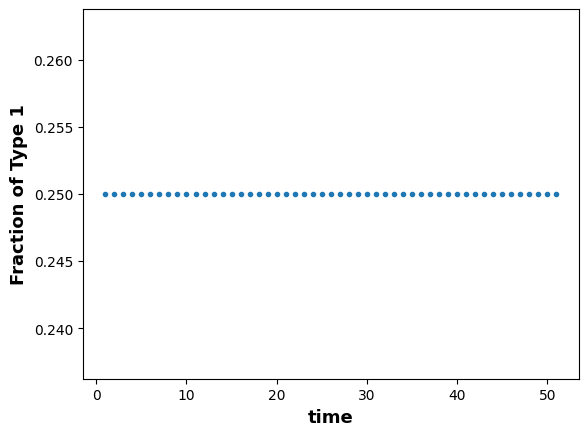

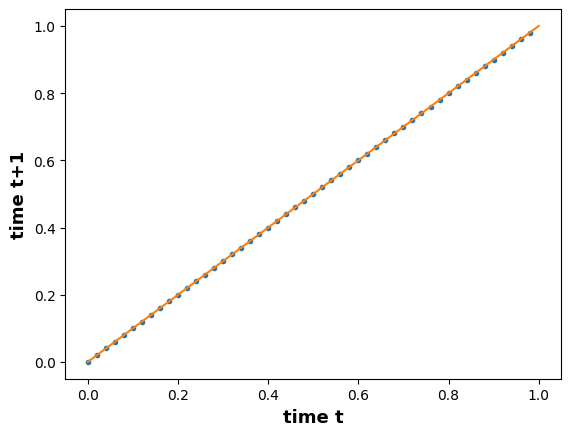

In [ ]:
def play_one_gen(p):
    p_nxt_gen = (p * W1) / ((p * W1) + (1 - p)*W2)
    return p_nxt_gen

def play(generation = 50):
    history = [p1]

    for _ in range(generation):
        prev_p1 = history[-1]
        history.append(play_one_gen(prev_p1))

    return history

def plot_fractions(history):
    x = range(1,1+len(history))
    y = history
    fig, ax = plt.subplots()
    ax.set_xlabel('time', fontsize=13,fontweight="bold")
    ax.set_ylabel('Fraction of Type 1', fontsize=13,fontweight="bold")    
    plt.plot(x, y,".")
    plt.show()

def plot_propotion_timestep(time_step = 50):
    x = []
    y = []

    for i in range(time_step):
        p = i/time_step

        x.append(p)
        y.append(play_one_gen(p))

    fig, ax = plt.subplots()
    ax.set_xlabel('time t', fontsize=13,fontweight="bold")
    ax.set_ylabel('time t+1', fontsize=13,fontweight="bold")    
    plt.plot(x, y,".")

    bobo = [0, 1]
    plt.plot(bobo, bobo)

    plt.show()

history = play()
plot_fractions(history)
plot_propotion_timestep()


Let's break down the scenarios:

1. **Both Cooperate (Coop-Coop):** This represents the optimal handover scenario. Both agents are actively working towards a common goal, ensuring a seamless and efficient handover. In the context of the provided matrix, when both Type I and Type II agents choose strategies that aim to find a specific item (e.g., 'Find A' or 'Find B'), they are working cooperatively, leading to the best combined outcome. In terms of payoff, the (60,60) result represents the maximum joint utility, signifying that both agents benefit the most from this collaborative approach.

2. **One Cooperates, One Defects (Coop-Defect or Defect-Coop):** This scenario is sub-optimal. One agent is working towards the common goal while the other is not, resulting in a handover process that is less efficient than when both cooperate. The defector may get a short-term advantage, as seen in some payoffs like (10,20) or (20,10), but this comes at the expense of the overall efficiency. The cooperator gets a lower payoff because their effort isn't reciprocated, making the handover less effective.

3. **Both Defect (Defect-Defect):** This represents the least efficient handover scenario. Neither agent is genuinely working towards a seamless handover, causing possible delays, miscommunications, or missed opportunities. The (1,1) result in the matrix highlights the minimal utility both agents receive when neither is willing to cooperate. Their mutual lack of cooperation harms both their individual and combined outcomes.


**1. Dominant Strategy**

A dominant strategy for a player in a game is one where that strategy is the best one to adopt regardless of what strategy the other players adopt.

For Agent I: From the table, the strategy "Find A, Find Agent 2" consistently provides the highest payoff across all strategies of Agent II, making it the dominant strategy for Agent I.

For Agent II: The strategy "Find Agent 1, Find B" provides the highest payoff when Agent I plays its dominant strategy, making it the dominant strategy for Agent II.

Given the matrix, it can be observed that for every choice of strategy by Type I, there's a better strategy option that yields a higher payoff. This indicates that Type II's choices are being dominated by Type I's strategy.

**2. Pareto Optimal**

The Pareto Optimal outcome is where both agents have the maximum possible payoff without making the other worse. By observing the table, the highest possible payoff for both agents is **(60, 60)**. No other strategy combination provides both agents with a jointly higher payoff. Any deviation from this strategy by any agent results in a reduced payoff for both agents. In this case, it’s when “Find A, Find Agent 2” for Agent 1 and “Find Agent 1, Find B” for Agent 2 is Pareto Optimal. Both agents working together in tandem towards a common goal (both "cooperating") represents the best handover scenario. Their combined efforts result in the maximum joint utility, signifying an efficient handover.

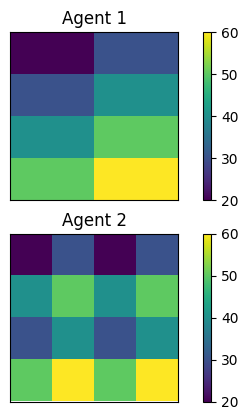

In [ ]:
import matplotlib.pyplot as plt

p1 = plt.subplot(2, 1, 1)
a = [[20, 20, 30, 30],
     [30, 30, 40, 40],
     [40, 40, 50, 50],
     [50, 50, 60, 60]]
plt.title('Agent 1')
plt.imshow(a)
ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.colorbar()


plt.subplot(2, 1, 2 )
a = [[20, 30, 20, 30],
     [40, 50, 40, 50],
     [30, 40, 30, 40],
     [50, 60, 50, 60]]
plt.title('Agent 2')
plt.imshow(a)
ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.colorbar()

plt.show()

**3. Nash Equilibrium**

A Nash equilibrium is a situation where neither player has an incentive to deviate from their chosen strategy given the choice of the other player.

<u>*Pure Strategy Nash Equilibrium:*</u>
The combination where Agent I chooses "Find A, Find Agent 2" and Agent II chooses "Find Agent 1, Find B" is a Nash Equilibrium. If Agent I is playing "Find A, Find Agent 2", Agent II's best response is "Find Agent 1, Find B". And if Agent II is playing "Find Agent 1, Find B", Agent I's best response is "Find A, Find Agent 2". Neither has an incentive to deviate unilaterally.


<u>*Mixed Strategy Nash Equilibrium:*</u>
Finding a mixed-strategy Nash equilibrium can be more complex, as it involves players randomizing over their strategies. Given that there are pure dominant strategies for both players, they will always prefer their dominant strategy over any mixed strategy. Hence, there is no mixed-strategy Nash equilibrium in this game.




Given the above, it's reasonable to expect convergence towards the strategies that are Nash Equilibrium, especially the Pareto optimal one, as both agents optimize their rewards. So, the system should converge on the strategy combination "Find A, Find Agent 2" for Agent I and "Find Agent 1, Find B" for Agent II. 

In summary, both game-theoretical analysis and the payoff matrix indicate that the best course of action for both agents is to focus on their specialized tasks and cooperate to seek each other for the handover before delivering to point B.


# Evolution Stability

![evolution_stationary.png](attachment:evolution_stationary.png)

1. **Defect, Defect (Both act randomly):**
Looking at the first matrix, when both adopt the "Random Policy, Random Policy" strategy, we get the payoff (20, 20). This represents mutual defection, where neither agent benefits significantly.

2. **Defect, Coop (Type I defects while Type II cooperates):**
The closest representation for Type I defecting and Type II cooperating in the first matrix would be "Random Policy, Random Policy" for Type I and "Find Agent I, Find B" for Type II. The payoff for such strategies is (30, 50). 

3. **Coop, Defect (Type I cooperates while Type II defects):**
Now, the opposite, where Type I adopts "Find A, Find Agent II" and Type II goes with "Random Policy, Random Policy". As established above, the payoff is (50, 30).

4. **Coop, Coop (Both cooperate):**
This can be directly taken as Type I adopting "Find A, Find Agent II" and Type II adopting "Find Agent I, Find B", which results in the payoff (60, 60).

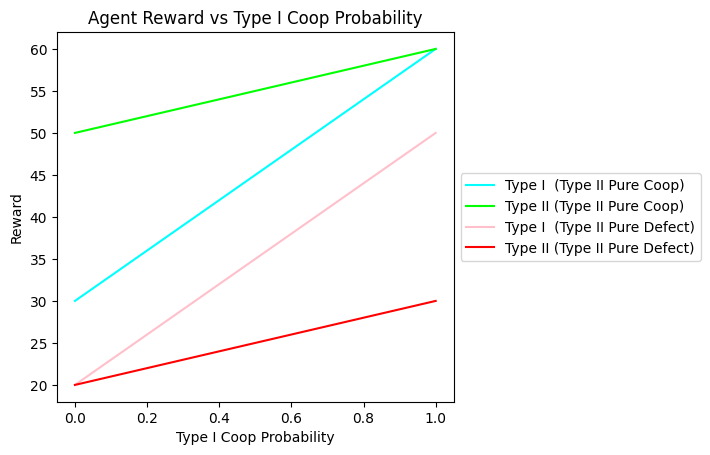

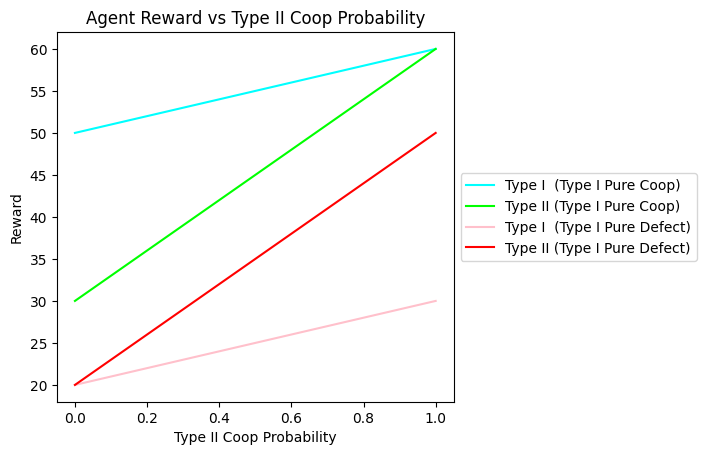

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

PAYOFF_1S = np.array([[20, 30],
                      [50, 60]])
PAYOFF_2S = np.array([[20, 50],
                      [30, 60]])

def plot_evo_stability(payoff_1, payoff_2, type=1):
    """
        Observe the evolution stability between 2 population.

    Args:
        payoff1: Payoff matrix for Type 1.
        payoff2: Payoff matrix for Type 2.
        type: Population type that exercise mixed strategy.
    """
    fig = plt.figure()
    ax  = plt.subplot(111)

    x_axis = [0, 1]

    if type == 1:
        ax.plot(x_axis, [payoff_1[0][1], payoff_1[1][1]], label = 'Type I  (Type II Pure Coop)', color = 'cyan')
        ax.plot(x_axis, [payoff_2[0][1], payoff_2[1][1]], label = 'Type II (Type II Pure Coop)', color = 'lime')
        ax.plot(x_axis, [payoff_1[0][0], payoff_1[1][0]], label = 'Type I  (Type II Pure Defect)', color = 'pink')
        ax.plot(x_axis, [payoff_2[0][0], payoff_2[1][0]], label = 'Type II (Type II Pure Defect)', color = 'red')

        plt.xlabel('Type I Coop Probability')
        plt.title('Agent Reward vs Type I Coop Probability')
    elif type == 2:
        ax.plot(x_axis, [payoff_1[1][0], payoff_1[1][1]], label = 'Type I  (Type I Pure Coop)', color = 'cyan')
        ax.plot(x_axis, [payoff_2[1][0], payoff_2[1][1]], label = 'Type II (Type I Pure Coop)', color = 'lime')
        ax.plot(x_axis, [payoff_1[0][0], payoff_1[0][1]], label = 'Type I  (Type I Pure Defect)', color = 'pink')
        ax.plot(x_axis, [payoff_2[0][0], payoff_2[0][1]], label = 'Type II (Type I Pure Defect)', color = 'red')

        plt.xlabel('Type II Coop Probability')
        plt.title('Agent Reward vs Type II Coop Probability')

    plt.ylabel('Reward')


    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Put a legend to the right of the current axis
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.show()


plot_evo_stability(PAYOFF_1S, PAYOFF_2S, type=1)
plot_evo_stability(PAYOFF_1S, PAYOFF_2S, type=2)


The first graph depicts the rewards for both Type I and Type II agents based on the probability of Type I cooperating (ranging from 0, meaning never cooperates, to 1, meaning always cooperates). The graph showcases four lines:

1. Reward for Type I when Type II purely cooperates.

2. Reward for Type II when Type II purely cooperates.

3. Reward for Type I when Type II purely defects.

4. Reward for Type II when Type II purely defects.

The second graph depicts the rewards for both Type I and Type II agents based on the probability of Type II cooperating (ranging from 0, meaning never cooperates, to 1, meaning always cooperates). The graph showcases four lines:

1. Reward for Type I when Type I purely cooperates.

2. Reward for Type II when Type I purely cooperates.

3. Reward for Type I when Type I purely defects.

4. Reward for Type II when Type I purely defects.

From the matrix and reward, we can deduce the following:

1.  **<u> Dominant Strategy Analysis: </u>**

**For Type I:**

if Type II defects, Type I gets a payoff of 20 by defecting and 50 by cooperating. Therefore, cooperating is better.
If Type II cooperates, Type I gets a payoff of 30 by defecting and 60 by cooperating. Again, cooperating is better.
So, Type I has a dominant strategy to cooperate.

**For Type II:**

If Type I defects, Type II gets a payoff of 20 by defecting and 50 by cooperating. Therefore, cooperating is better.
If Type I cooperates, Type II gets a payoff of 30 by defecting and 60 by cooperating. Again, cooperating is better.
So, Type II also has a dominant strategy to cooperate.

2. **<u> Pareto Optimal: </u>**

The outcome where both agents cooperate and get (60, 60) is Pareto optimal. This is because no other outcome in the matrix gives both agents a higher or equivalent payoff without making at least one of them worse off.

3. **<u> Nash Equilibrium: </u>**

- **Pure Strategy Nash Equilibrium Analysis:** Since both Type I and Type II have dominant strategies to cooperate, the outcome (60, 60) where both cooperate is a Pure Nash Equilibrium. Here, neither Type I nor Type II would want to change their strategy of cooperating, as defecting would reduce their payoff.

- **Mixed Strategy Nash Equilibrium Analysis:** For mixed strategy Nash equilibrium, players randomize their strategies such that they are indifferent between their available actions.

To summarize, both Type I and Type II have a dominant strategy to Cooperate. The outcome where both cooperate (60, 60) is both Pareto Optimal and a Nash Equilibrium. This suggests that in this game, mutual cooperation is the most favourable and stable outcome for both players.

# Replicator Dynamics

#### Population Payoff

![population_payoff.png](attachment:population_payoff.png)

To get a 2x2 population payoff matrix from the given 4x4 matrix, we'll calculate the average payoff for each combination of the aggregated strategies for Type I and Type II.


1. Combine "Random Policy, Random Policy" of Type I and "Random Policy, Random Policy" and Type II into one aggregated strategy we can call "Defect & Defect".

2. Combine "Find A, Random Policy" and "Random Policy, Find Agent II" of Type I into another aggregated strategy we can call "Defect & Coop"

3. Combine "Random Policy, Find B" and "Find Agent I, Random Policy" of Type II into another aggregated strategy we can call "Coop & Defect".

4. Combine "Find A, Find Agent II" of Type I and "Find Agent I, Find B" of Type II into another aggregated strategy we can call "Coop & Coop".

**Defect & Defect:**

$(20+20)/2 = 20$

$(20+40)/2 = 30$

$(30+30)/2 = 30$

$(30+50)/2 = 40$

Average: $(20+30+30+40)/2 = 30$

**Defect & Coop:**

$(40+20)/2 = 30$

$(40+40)/2 = 40$

$(50+30)/2 = 40$

$(50+50)/2 = 50$

Average: $(30+40+40+50)/2 = 40$

**Coop & Defect:**

$(30+30)/2 = 30$

$(30+50)/2 = 40$

$(40+40)/2 = 40$

$(40+60)/2 = 50$

Average: $(30+40+40+50)/2 = 40$

**Coop & Coop:**

$(50+30)/2 = 40$

$(50+50)/2 = 50$

$(60+40)/2 = 50$

$(60+60)/2 = 60$

Average: $(40+50+50+60)/2 = 50$

#### Action Payoff

![action_payoff.png](attachment:action_payoff.png)

From the Evolution Stability payoff matrix, we can get the action payoff for both agent types as follows. (Type I and Type II Agent have the same payoff)

Defect & Defect: 20

Defect & Coop: 30

Coop & Defect: 50

Coop & Coop: 60

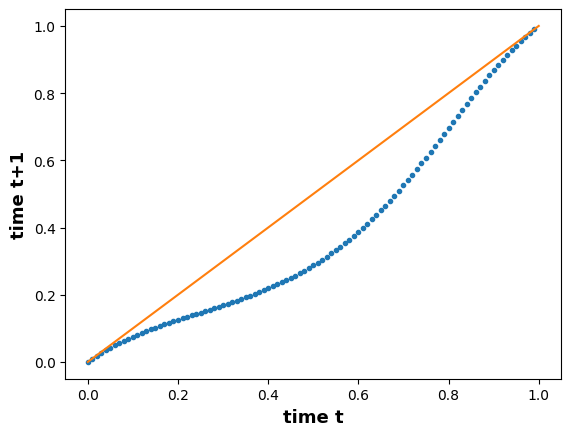

In [ ]:
POPULATION_PAYOFF = np.array([[30, 40],  # For Type 1 & Type 2
                              [40, 50]])

ACTION_PAYOFF = np.array([[20, 30], # For Defect & Coop
                          [50, 60]])
LEARN_RATE = 0.17

def play_one_gen(p, A):
    x = np.array([[p, 1-p]]).T
    # Week 7 Population Game - Slide 40 - Replicator Equation
    x_1 = x[0][0]*((A@x)[0][0] - (x.T @ A @ x)[0][0])
    x_2 = x[1][0]*((A@x)[1][0] - (x.T @ A @ x)[0][0])

    # According to slides xi_1 & xi_2 are rate of change over time, I look at the value but they don't make sense to me
    # You can print out to see the value
    # print(xi_1, xi_2)

    x1_nxt_round_p = p*(1+x_1*LEARN_RATE)              # I set learning rate to 0.17, somehow the graphs looks fine  
    x2_nxt_round_p = (1-p)*(1+x_2*LEARN_RATE)

    res = x1_nxt_round_p/(x1_nxt_round_p + x2_nxt_round_p)

    return res


def plot_propotion_timestep(A, time_step = 100):
    x = []
    y = []

    for i in range(time_step):
        p = i/time_step

        x.append(p)        # p = Proportion of Type 1 (A) / Probability to Defect (B) 
        y.append(play_one_gen(p, A))

    fig, ax = plt.subplots()
    ax.set_xlabel('time t', fontsize=13,fontweight="bold")
    ax.set_ylabel('time t+1', fontsize=13,fontweight="bold")    
    plt.plot(x, y,".")

    bobo = [0, 1]
    plt.plot(bobo, bobo)
    # plt.axvline(x=A[0][1]/np.sum(A), color='red', linestyle='--')
    # plt.axhline(y=A[0][1]/np.sum(A), color='red', linestyle='--')


    plt.show()

# history = play()
# plot_fractions(history)
plot_propotion_timestep(POPULATION_PAYOFF)


**Adaptive Behavior:**

The dynamics portrayed by the blue dots reveal an adaptive behavior in the population. Depending on which strategy or type has a higher relative payoff, the population shifts its proportions to increase the prevalence of the more successful strategy or type.


**Stability and Instability Regions:**

Areas where the blue dots closely follow the orange line are regions of stability. Small changes in proportions lead to minimal shifts in the next generation.
In contrast, regions where the blue dots deviate significantly from the orange line are unstable. Here, even slight changes in proportions can result in significant shifts in the next generation.


**Sensitivity to Initial Proportions:**

The graph suggests sensitivity to initial conditions. Starting with a specific proportion of Type I can lead the population down different trajectories over time.

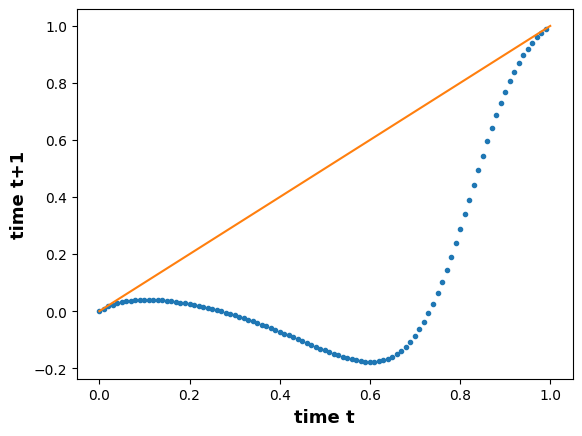

In [ ]:
plot_propotion_timestep(ACTION_PAYOFF)

"Coop" is performing better than the average performance of all strategies in the population, the proportion of "Coop" strategies in the population is increasing over time.

For an agent meeting a defector: Cooperating (10) yields a higher payoff than defecting (-20). Thus, based on this, if many agents in the population are defecting, there's an incentive for an agent to cooperate.

For an agent meeting a cooperator: Cooperating (20) yields a higher payoff than defecting (10). This reinforces the notion that cooperation is beneficial.

1. **Stable States & Convergence:**
The curve is below $y=x$ and will converge to $p=0$ in the replicator dynamics graph, it means the population will ultimately adopt the "Coop" strategy.
Given our matrix, this makes sense. "Coop" has a higher payoff against both defectors and cooperators compared to "Defect." So, over time, as agents adjust their strategies based on the payoffs they observe, the proportion of "Coop" strategies in the population should increase. If everyone starts by defecting, and some random mutations or changes cause some individuals to switch to cooperating, those cooperators would fare better on average than the defectors. Over time, this would cause the proportion of cooperators to increase.

2. **Equilibrium:**
An equilibrium in the context of replicator dynamics is a state where the proportions of strategies in the population do not change. This could be because one strategy completely dominates (like "Coop" in our case) or because there's a stable mix of strategies. In the given matrix, the dynamics push the population towards mutual cooperation. So, even though "Defect, Defect" is a Nash Equilibrium, it's not stable in the face of the replicator dynamics if there's any deviation or change. "Coop, Coop" is both a Nash Equilibrium and would be a stable state in the replicator dynamics, given the payoffs.

In conclusion, the replicator dynamics based on this payoff matrix suggest that cooperation will be the dominant strategy in the long run, despite the presence of a "Defect, Defect" Nash Equilibrium. This is because cooperation offers higher rewards for players compared to defecting, regardless of the opponent's strategy.

## Question 4: Replicator Simulation

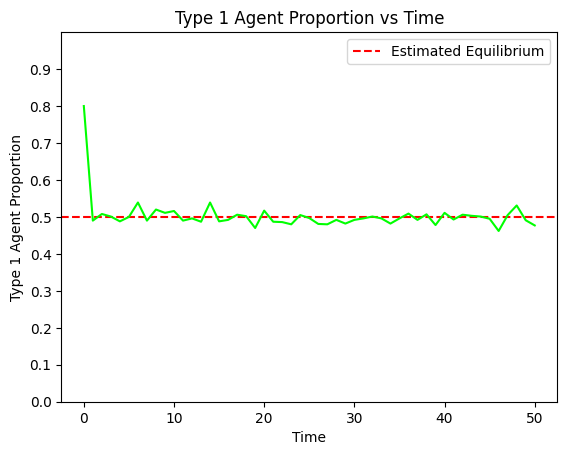

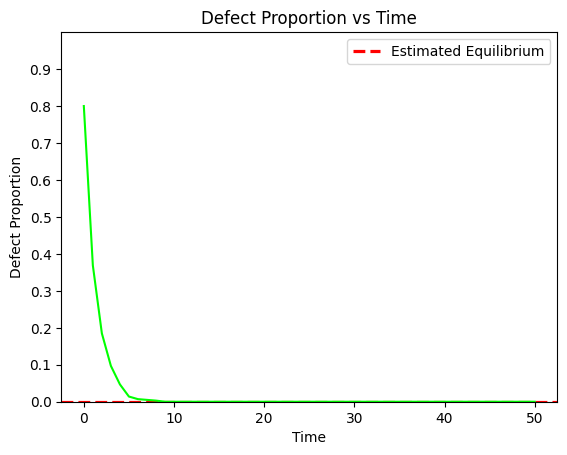

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

POPULATION_SIZE = 1000
GAME_SIZE = 200
ITERATION = 50
POPULATION_PAYOFF = np.array([[0, 1],  # For Type 1 & Type 2
                              [1, 0]])
ACTION_PAYOFF = np.array([[0, 10], # For Defect & Coop
                          [10, 20]])

def play_game(population, payoff):
    """
        The population play the playoff game for a evolution.  
        It estimates the payoff for each type.

    Args:
        population: The population, 1 for type 1, 0 for type 2.
        payoff: Payoff matrix.
    """
    p1 = sum(population)/len(population)  # Type 1 Proportion
    p2 = 1 - p1                           # Type 2 Proportion

    x = np.array([[p1, p2]]).T
    x_1 = (payoff@x)[0][0]   # Type 1 Avg Payoff 
    x_2 = (payoff@x)[1][0]   # Type 2 Avg Payoff

    payoff_1 = x_1/(x_1 + x_2)  # Ratio of x_1 in Total Payoff 
    payoff_2 = x_2/(x_1 + x_2)  # Ratio of x_2 in Total Payoff 

    payoffs = np.where(population==1,payoff_1,payoff_2)

    return payoffs


def one_round(population, payoff):
    """
        The population are splitted into few groups, each group plays the playoff game for an iteration. 
        Next, the population evolve for next generation.

    Args:
        population: The population, 1 for type 1, 0 for type 2.
        payoff: Payoff matrix.
    """
    np.random.shuffle(population)

    all_games   = np.split(population, POPULATION_SIZE/GAME_SIZE)                  # Split a Population into Multiple Games            
    all_payoffs = np.array([play_game(game, payoff) for game in all_games]).flatten()   # Play the Games
    indices = np.random.choice(np.arange(0,POPULATION_SIZE),POPULATION_SIZE,       # Select Type for Next Round
                               replace=True,
                               p=all_payoffs/np.sum(all_payoffs))
    parents = np.array([population[i] for i in indices])
    
    return parents

def play(p, payoff, iteration = ITERATION):
    """
        This function plays a playoff game on a population, the observe the proportion of the population. 

    Args:
        population: The population, 1 for type 1, 0 for type 2.
        payoff: Payoff matrix.
    """
    size_1 = int(POPULATION_SIZE*p)      # Type 1 size, represented with 1.
    size_2 = POPULATION_SIZE - size_1    # Type 2 size, represented with 0.
    population = np.array([1] * size_1 + [0] * size_2)

    his = [p]       # History of Type 1 Proportion

    for _ in range(iteration):
        population = one_round(population, payoff)
        his.append(sum(population)/POPULATION_SIZE)

    return his


def plot_agent_type(p, payoff):
    """
        Plot the evolution dynamics graph for agent type.

    Args:
        p : Probability of type 1 population.
        payoff: Payoff matrix.
    """
    y = play(p, payoff)
    x = [i for i in range(ITERATION+1)]

    plt.clf()

    plt.title('Type 1 Agent Proportion vs Time')
    plt.axhline(0.5, linestyle='--', color='red', label = 'Estimated Equilibrium')

    plt.xlabel('Time')
    plt.ylabel('Type 1 Agent Proportion')
    plt.yticks(np.arange(0, 1, step=0.1))
    plt.ylim([0, 1])

    plt.plot(x, y, color='lime')
    plt.legend()
    plt.show()

def plot_action_type(p, payoff):
    """
        Plot the evolution dynamics graph for action type.

    Args:
        p : Probability of type 1 population.
        payoff: Payoff matrix.
    """
    y = play(p, payoff)
    x = [i for i in range(ITERATION+1)]

    plt.title('Defect Proportion vs Time')
    plt.axhline(0, linestyle='--', color='red', linewidth = 2.3, label = 'Estimated Equilibrium')
    plt.xlabel('Time')
    plt.ylabel('Defect Proportion')
    plt.yticks(np.arange(0, 1, step=0.1))
    plt.ylim([0, 1])

    plt.plot(x, y, color='lime')
    plt.legend()
    plt.show()

plot_agent_type(0.8, POPULATION_PAYOFF)
plot_action_type(0.8, ACTION_PAYOFF)
